In [ ]:
import zipfile, os
import shutil
import math
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
import tensorflow.keras.utils 

1. Getting and Preparing Data

In [ ]:
#Getting the Data
# downloading the files from dropbox
!wget --no-check-certificate  https://uofi.box.com/shared/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip -O intel-images.zip

#extrac the zip file downloaded
zip_ref = zipfile.ZipFile('intel-images.zip', 'r')
zip_ref.extractall()


--2022-10-24 21:13:32--  https://uofi.box.com/shared/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip
Resolving uofi.box.com (uofi.box.com)... 74.112.186.144
Connecting to uofi.box.com (uofi.box.com)|74.112.186.144|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip [following]
--2022-10-24 21:13:32--  https://uofi.box.com/public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip
Reusing existing connection to uofi.box.com:443.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://uofi.app.box.com/public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip [following]
--2022-10-24 21:13:32--  https://uofi.app.box.com/public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip
Resolving uofi.app.box.com (uofi.app.box.com)... 74.112.186.144
Connecting to uofi.app.box.com (uofi.app.box.com)|74.112.186.144|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://dl2.boxcloud

In [ ]:
def count_images(dir):
    count = {"buildings": 0, "forest": 0, "glacier": 0,
             "mountain": 0, "sea": 0, "street": 0}
    for i in os.listdir(dir):
        count[i] = len(os.listdir(dir + "/" + i))
    return count

test_count = count_images("intel/seg_test/")
train_count = count_images("intel/seg_train/")



In [ ]:
print(test_count, train_count)

{'buildings': 437, 'forest': 474, 'glacier': 553, 'mountain': 525, 'sea': 510, 'street': 501} {'buildings': 2191, 'forest': 2271, 'glacier': 2404, 'mountain': 2512, 'sea': 2274, 'street': 2382}


In [ ]:
shutil.rmtree("intel/seg_val")

FileNotFoundError: ignored

In [ ]:
test_dir="intel/seg_test/"
train_dir = "intel/seg_train/"
val_dir = "intel/seg_val/"

os.mkdir(val_dir + "/")
for i in os.listdir(train_dir):
  os.mkdir(val_dir + "/" + i)
  for j in os.listdir(train_dir + "/" + i)[:int(len(os.listdir(train_dir + "/" + i)) * 0.2)]:
    os.rename(train_dir + "/" + i + "/" + j, val_dir + "/" + i + "/" + j)
    

In [ ]:
val_count=count_images("intel/seg_val")
print(val_count)

{'buildings': 438, 'forest': 454, 'glacier': 480, 'mountain': 502, 'sea': 454, 'street': 476}


In [ ]:
from tensorflow.keras.preprocessing import image_dataset_from_directory
train_dataset = image_dataset_from_directory(
train_dir,
image_size=(150, 150),
batch_size=32)


validation_dataset = image_dataset_from_directory(
val_dir,
image_size=(150, 150),
batch_size=32)


test_dataset = image_dataset_from_directory(
test_dir,
image_size=(150, 150),
batch_size=32)

Found 11230 files belonging to 6 classes.
Found 2804 files belonging to 6 classes.
Found 3000 files belonging to 6 classes.


1.Creating a baseline model

In [ ]:
def build_baseline(input_shape, filters):

  #Configuring the model architecture

  #input layer for getting the input image
  input = keras.Input(shape=input_shape)

  #rescaling layer for rescalign pixels to [0,1] range
  x = layers.experimental.preprocessing.Rescaling(1./255)(input)


  for filter in filters:
    #A block of one conv+batchnorm+relu  layers for extractign features
    x =layers.Conv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
    x= layers.BatchNormalization()(x)
    x= layers.ReLU()(x)

    #max pooling for downsampling
    x = layers.MaxPooling2D(pool_size=2, padding="same")(x)

  #Global Average pooling. This will get an input of shape (height, width, channels) the average of each feature map and returns a vector of size channels.
  x = layers.GlobalAveragePooling2D()(x)

  #The final output layer has 6 neurons with softmax activation to output the probability of the target class 
  output=layers.Dense(6, activation="softmax")(x)
  #create a model and set its input and output and return it
  model = keras.Model(inputs=input, outputs=output)
  return model
baseline=build_baseline(input_shape=(150,150,3), filters=[32,64,128, 256])
print(baseline.summary())

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 150, 150, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 150, 150, 32)      864       
                                                                 
 batch_normalization (BatchN  (None, 150, 150, 32)     128       
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 150, 150, 32)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 75, 75, 32)       0         
 )                                                           

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3,
    decay_steps=1000,
    decay_rate=0.9)

#compiling the mode
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
baseline.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=['accuracy'], optimizer=opt) 

#callback for early stopping. stop the training if the validation_loss does not improve after 10 epochs
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, min_delta=1e-4, restore_best_weights=True)

#save the checkpointed model in your google drive cnn_lab directory: "drive/MyDrive/cnn_lab/baseline_checkpoint" . 
checkpoint= keras.callbacks.ModelCheckpoint( filepath="drive/MyDrive/cnn_lab/baseline_checkpoint",save_best_only=True, monitor="val_loss")

history = baseline.fit(
            train_dataset,
            validation_data = validation_dataset,
            epochs = 50,
            verbose = 1,
            callbacks=[early_stopping, checkpoint])

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 0.8022 - accuracy: 0.6963

351/351 [==============================] - 32s 60ms/step - loss: 0.8022 - accuracy: 0.6963 - val_loss: 1.5747 - val_accuracy: 0.3987
Epoch 2/50
350/351 [============================>.] - ETA: 0s - loss: 0.6021 - accuracy: 0.7800

351/351 [==============================] - 17s 48ms/step - loss: 0.6018 - accuracy: 0.7801 - val_loss: 1.0443 - val_accuracy: 0.6680
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.5326 - accuracy: 0.8061

351/351 [==============================] - 17s 49ms/step - loss: 0.5326 - accuracy: 0.8061 - val_loss: 0.6489 - val_accuracy: 0.7814
Epoch 4/50
351/351 [==============================] - 15s 43ms/step - loss: 0.4850 - accuracy: 0.8281 - val_loss: 0.9686 - val_accuracy: 0.6723
Epoch 5/50
351/351 [==============================] - 16s 46ms/step - loss: 0.4521 - accuracy: 0.8397 - val_loss: 0.8656 - val_accuracy: 0.6655
Epoch 6/50
350/351 [============================>.] - ETA: 0s - loss: 0.4236 - accuracy: 0.8468

351/351 [==============================] - 17s 48ms/step - loss: 0.4235 - accuracy: 0.8467 - val_loss: 0.5880 - val_accuracy: 0.7782
Epoch 7/50
351/351 [==============================] - 15s 44ms/step - loss: 0.4071 - accuracy: 0.8536 - val_loss: 0.9880 - val_accuracy: 0.6904
Epoch 8/50
351/351 [==============================] - 15s 44ms/step - loss: 0.3819 - accuracy: 0.8663 - val_loss: 2.6049 - val_accuracy: 0.4219
Epoch 9/50
350/351 [============================>.] - ETA: 0s - loss: 0.3613 - accuracy: 0.8694

351/351 [==============================] - 17s 49ms/step - loss: 0.3609 - accuracy: 0.8694 - val_loss: 0.4763 - val_accuracy: 0.8228
Epoch 10/50
351/351 [==============================] - ETA: 0s - loss: 0.3469 - accuracy: 0.8760

351/351 [==============================] - 17s 49ms/step - loss: 0.3469 - accuracy: 0.8760 - val_loss: 0.4158 - val_accuracy: 0.8623
Epoch 11/50
351/351 [==============================] - 16s 44ms/step - loss: 0.3318 - accuracy: 0.8838 - val_loss: 0.4766 - val_accuracy: 0.8345
Epoch 12/50
351/351 [==============================] - 16s 44ms/step - loss: 0.3170 - accuracy: 0.8868 - val_loss: 0.5424 - val_accuracy: 0.8178
Epoch 13/50
351/351 [==============================] - 15s 44ms/step - loss: 0.3062 - accuracy: 0.8915 - val_loss: 0.7064 - val_accuracy: 0.7443
Epoch 14/50
351/351 [==============================] - 16s 44ms/step - loss: 0.2947 - accuracy: 0.8949 - val_loss: 0.6094 - val_accuracy: 0.7924
Epoch 15/50
351/351 [==============================] - 15s 44ms/step - loss: 0.2838 - accuracy: 0.8986 - val_loss: 0.8194 - val_accuracy: 0.7386
Epoch 16/50
351/351 [==============================] - 16s 44ms/step - loss: 0.2717 - accuracy: 0.9017 - val_loss: 0.5077 - val_accuracy: 0.82

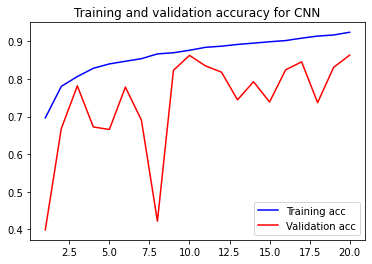

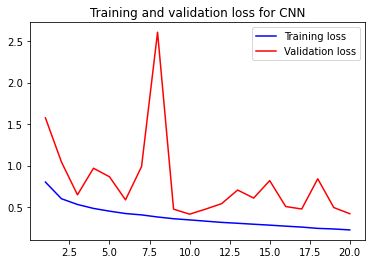

In [ ]:

#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

Model is  over fitting validation loss drops to 0.4158 and starts to increase and bounces around and we got the validation accuracy of 86%

Adding more layers to the baseline model

In [ ]:
def build_baseline(input_shape, filters):

  #Configuring the model architecture

  #input layer for getting the input image
  input = keras.Input(shape=input_shape)

  #rescaling layer for rescalign pixels to [0,1] range
  x = layers.experimental.preprocessing.Rescaling(1./255)(input)


  for filter in filters:
    #A block of one conv+batchnorm+relu  layers for extractign features
    x =layers.Conv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
    x= layers.BatchNormalization()(x)
    x= layers.ReLU()(x)

    x =layers.Conv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
    x= layers.BatchNormalization()(x)
    x= layers.ReLU()(x)
   
    #max pooling for downsampling
    x = layers.MaxPooling2D(pool_size=2, padding="same")(x)

  #Global Average pooling. This will get an input of shape (height, width, channels) the average of each feature map and returns a vector of size channels.
  x = layers.GlobalAveragePooling2D()(x)

  #The final output layer has 6 neurons with softmax activation to output the probability of the target class 
  output=layers.Dense(6, activation="softmax")(x)
  #create a model and set its input and output and return it
  model = keras.Model(inputs=input, outputs=output)
  return model

baseline_addlayers=build_baseline(input_shape=(150,150,3), filters=[32,64,128,256,512])
print(baseline_addlayers.summary())

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 rescaling_1 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 conv2d_4 (Conv2D)           (None, 150, 150, 32)      864       
                                                                 
 batch_normalization_4 (Batc  (None, 150, 150, 32)     128       
 hNormalization)                                                 
                                                                 
 re_lu_4 (ReLU)              (None, 150, 150, 32)      0         
                                                                 
 conv2d_5 (Conv2D)           (None, 150, 150, 32)      9216      
                                                           

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3,
    decay_steps=1000,
    decay_rate=0.9)

#compiling the mode
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
baseline_addlayers.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=['accuracy'], optimizer=opt) 

#callback for early stopping. stop the training if the validation_loss does not improve after 10 epochs
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, min_delta=1e-4, restore_best_weights=True)

#save the checkpointed model in your google drive cnn_lab directory: "drive/MyDrive/cnn_lab/baseline_checkpoint" . 
checkpoint= keras.callbacks.ModelCheckpoint( filepath="drive/MyDrive/cnn_lab/baselineadditionallayers_checkpoint",save_best_only=True, monitor="val_loss")

history = baseline_addlayers.fit(
            train_dataset,
            validation_data = validation_dataset,
            epochs = 50,
            verbose = 1,
            callbacks=[early_stopping, checkpoint])

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 0.8773 - accuracy: 0.6686

351/351 [==============================] - 49s 133ms/step - loss: 0.8773 - accuracy: 0.6686 - val_loss: 1.7877 - val_accuracy: 0.4811
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.5915 - accuracy: 0.7844

351/351 [==============================] - 41s 117ms/step - loss: 0.5915 - accuracy: 0.7844 - val_loss: 0.9658 - val_accuracy: 0.6690
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.5184 - accuracy: 0.8106

351/351 [==============================] - 41s 117ms/step - loss: 0.5184 - accuracy: 0.8106 - val_loss: 0.8075 - val_accuracy: 0.7011
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.4665 - accuracy: 0.8281

351/351 [==============================] - 41s 117ms/step - loss: 0.4665 - accuracy: 0.8281 - val_loss: 0.7508 - val_accuracy: 0.7614
Epoch 5/50
351/351 [==============================] - ETA: 0s - loss: 0.4360 - accuracy: 0.8444

351/351 [==============================] - 41s 116ms/step - loss: 0.4360 - accuracy: 0.8444 - val_loss: 0.6904 - val_accuracy: 0.7546
Epoch 6/50
351/351 [==============================] - ETA: 0s - loss: 0.3866 - accuracy: 0.8592

351/351 [==============================] - 41s 117ms/step - loss: 0.3866 - accuracy: 0.8592 - val_loss: 0.5660 - val_accuracy: 0.8046
Epoch 7/50
351/351 [==============================] - 37s 106ms/step - loss: 0.3745 - accuracy: 0.8683 - val_loss: 0.6832 - val_accuracy: 0.7575
Epoch 8/50
351/351 [==============================] - ETA: 0s - loss: 0.3499 - accuracy: 0.8738

351/351 [==============================] - 41s 116ms/step - loss: 0.3499 - accuracy: 0.8738 - val_loss: 0.4688 - val_accuracy: 0.8295
Epoch 9/50
351/351 [==============================] - 37s 106ms/step - loss: 0.3273 - accuracy: 0.8820 - val_loss: 0.8308 - val_accuracy: 0.7257
Epoch 10/50
351/351 [==============================] - 38s 107ms/step - loss: 0.3098 - accuracy: 0.8873 - val_loss: 0.6274 - val_accuracy: 0.7899
Epoch 11/50
351/351 [==============================] - ETA: 0s - loss: 0.2856 - accuracy: 0.8979

351/351 [==============================] - 41s 116ms/step - loss: 0.2856 - accuracy: 0.8979 - val_loss: 0.4385 - val_accuracy: 0.8556
Epoch 12/50
351/351 [==============================] - ETA: 0s - loss: 0.2628 - accuracy: 0.9070

351/351 [==============================] - 41s 116ms/step - loss: 0.2628 - accuracy: 0.9070 - val_loss: 0.3705 - val_accuracy: 0.8655
Epoch 13/50
351/351 [==============================] - 37s 106ms/step - loss: 0.2507 - accuracy: 0.9098 - val_loss: 1.0679 - val_accuracy: 0.6872
Epoch 14/50
351/351 [==============================] - ETA: 0s - loss: 0.2339 - accuracy: 0.9167

351/351 [==============================] - 41s 115ms/step - loss: 0.2339 - accuracy: 0.9167 - val_loss: 0.3431 - val_accuracy: 0.8877
Epoch 15/50
351/351 [==============================] - 37s 106ms/step - loss: 0.2059 - accuracy: 0.9264 - val_loss: 0.5027 - val_accuracy: 0.8224
Epoch 16/50
351/351 [==============================] - 37s 106ms/step - loss: 0.1967 - accuracy: 0.9276 - val_loss: 0.3855 - val_accuracy: 0.8709
Epoch 17/50
351/351 [==============================] - 37s 106ms/step - loss: 0.1826 - accuracy: 0.9349 - val_loss: 0.3766 - val_accuracy: 0.8837
Epoch 18/50
351/351 [==============================] - 37s 106ms/step - loss: 0.1606 - accuracy: 0.9432 - val_loss: 0.5041 - val_accuracy: 0.8417
Epoch 19/50
351/351 [==============================] - 37s 105ms/step - loss: 0.1403 - accuracy: 0.9516 - val_loss: 0.4464 - val_accuracy: 0.8595
Epoch 20/50
351/351 [==============================] - 37s 106ms/step - loss: 0.1298 - accuracy: 0.9540 - val_loss: 0.4622 - val_accurac

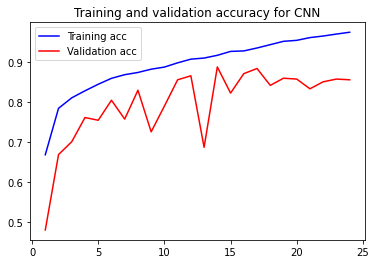

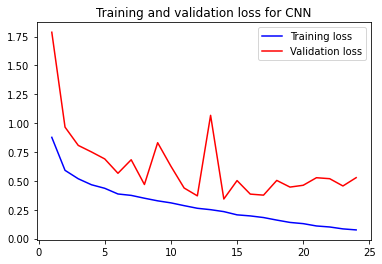

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

After adding layers the validation accuracy we got the validation accuracy of 88% with loss of 3431 but model is still overfitting

iii)Replacing convolutional layers with depth-wise separable convolution and add residual blocks.

In [ ]:
def residual_block(x, filter):
  
  residual = x
  
  # x goes through a block consisting of two conv2d+batchnorm+reul as well as a max pooling

  x = layers.SeparableConv2D(filters=filter, kernel_size=3, padding="same", use_bias=False )(x)
  x= layers.BatchNormalization()(x)
  x= layers.ReLU()(x)

  x = layers.SeparableConv2D(filters=filter, kernel_size=3, padding="same", use_bias=False )(x)
  x= layers.BatchNormalization()(x)
  x= layers.ReLU()(x)

  #max pooling for downsampling
  x = layers.MaxPooling2D(pool_size=2, padding="same")(x)
  
  # After going through the above block x now has "filter" channels and its feature map is downsampled to half by max pooling
  #so we need to use a 1*1 convolution with stride=2 to downsample residual and change its numebr of channels to "filter".
  residual = layers.Conv2D(filters=filter, kernel_size=1, strides=2, use_bias=False)(residual)
  
  #Having batchnormalization layer as usual after convolution
  residual= layers.BatchNormalization()(residual)


  x = layers.add([x, residual])
  return x

In [ ]:
def build_baseline(input_shape, filters):

  #Configuring the model architecture

  #input layer for getting the input image
  input = keras.Input(shape=input_shape)

  #rescaling layer for rescalign pixels to [0,1] range
  x = layers.experimental.preprocessing.Rescaling(1./255)(input)


  for filter in filters:
     x= residual_block(x, filter)

  #Global Average pooling. This will get an input of shape (height, width, channels) the average of each feature map and returns a vector of size channels.
  x = layers.GlobalAveragePooling2D()(x)

  x= layers.Dropout(0.5)(x)

  #The final output layer has 6 neurons with softmax activation to output the probability of the target class 
  output=layers.Dense(6, activation="softmax")(x)
  #create a model and set its input and output and return it
  model = keras.Model(inputs=input, outputs=output)
  return model

baseline_depthwise=build_baseline(input_shape=(150,150,3), filters=[32,64,128,256,512])
print(baseline_depthwise.summary())

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_2 (Rescaling)        (None, 150, 150, 3)  0           ['input_3[0][0]']                
                                                                                                  
 separable_conv2d (SeparableCon  (None, 150, 150, 32  123        ['rescaling_2[0][0]']            
 v2D)                           )                                                                 
                                                                                            

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3,
    decay_steps=1000,
    decay_rate=0.9)

#compiling the mode
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
baseline_depthwise.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=['accuracy'], optimizer=opt) 

#callback for early stopping. stop the training if the validation_loss does not improve after 10 epochs
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, min_delta=1e-4, restore_best_weights=True)

#save the checkpointed model in your google drive cnn_lab directory: "drive/MyDrive/cnn_lab/baseline_checkpoint" . 
checkpoint= keras.callbacks.ModelCheckpoint( filepath="drive/MyDrive/cnn_lab/baseline_checkpoint",save_best_only=True, monitor="val_loss")

history = baseline_depthwise.fit(
            train_dataset,
            validation_data = validation_dataset,
            epochs = 50,
            verbose = 1,
            callbacks=[early_stopping, checkpoint])

Epoch 1/50
351/351 [==============================] - ETA: 0s - loss: 1.0226 - accuracy: 0.6448

351/351 [==============================] - 91s 252ms/step - loss: 1.0226 - accuracy: 0.6448 - val_loss: 4.0816 - val_accuracy: 0.1619
Epoch 2/50
351/351 [==============================] - ETA: 0s - loss: 0.6309 - accuracy: 0.7706

351/351 [==============================] - 88s 249ms/step - loss: 0.6309 - accuracy: 0.7706 - val_loss: 1.3856 - val_accuracy: 0.6213
Epoch 3/50
351/351 [==============================] - ETA: 0s - loss: 0.5132 - accuracy: 0.8160

351/351 [==============================] - 87s 247ms/step - loss: 0.5132 - accuracy: 0.8160 - val_loss: 0.6900 - val_accuracy: 0.7821
Epoch 4/50
351/351 [==============================] - ETA: 0s - loss: 0.4422 - accuracy: 0.8428

351/351 [==============================] - 88s 249ms/step - loss: 0.4422 - accuracy: 0.8428 - val_loss: 0.6531 - val_accuracy: 0.7782
Epoch 5/50
351/351 [==============================] - ETA: 0s - loss: 0.3928 - accuracy: 0.8569

351/351 [==============================] - 88s 249ms/step - loss: 0.3928 - accuracy: 0.8569 - val_loss: 0.5209 - val_accuracy: 0.8267
Epoch 6/50
351/351 [==============================] - 82s 232ms/step - loss: 0.3409 - accuracy: 0.8761 - val_loss: 0.5492 - val_accuracy: 0.8146
Epoch 7/50
351/351 [==============================] - 81s 232ms/step - loss: 0.2959 - accuracy: 0.8939 - val_loss: 0.7944 - val_accuracy: 0.7896
Epoch 8/50
351/351 [==============================] - 82s 232ms/step - loss: 0.2607 - accuracy: 0.9066 - val_loss: 0.5719 - val_accuracy: 0.8335
Epoch 9/50
351/351 [==============================] - 82s 233ms/step - loss: 0.2026 - accuracy: 0.9289 - val_loss: 0.7049 - val_accuracy: 0.7942
Epoch 10/50
351/351 [==============================] - 82s 233ms/step - loss: 0.1743 - accuracy: 0.9351 - val_loss: 0.6884 - val_accuracy: 0.8267
Epoch 11/50
351/351 [==============================] - 82s 232ms/step - loss: 0.1542 - accuracy: 0.9436 - val_loss: 0.8183 - val_accuracy: 0

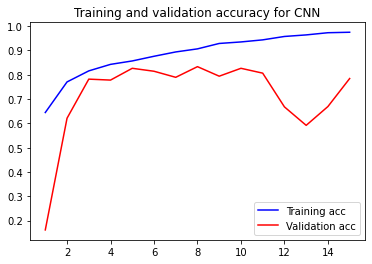

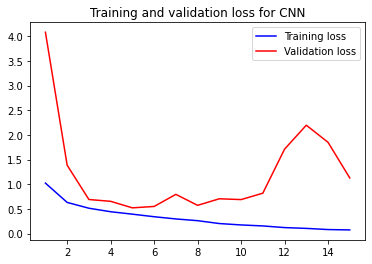

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

By adding depth-wise separable layers instead of convolutional layers the validation accuracy seems to be decreased but the gap between validation loss and training loss seems to be less.

Using data augmentation

In [ ]:
def data_augmentation(x):
  x= layers.experimental.preprocessing.RandomFlip("horizontal")(x)
  x=layers.experimental.preprocessing.RandomRotation(0.1)(x)
  x=layers.experimental.preprocessing.RandomZoom(0.2)(x)
  return x

In [ ]:
def residual_block(x, filter):
  
  residual = x
  
  # x goes through a block consisting of two conv2d+batchnorm+reul as well as a max pooling

  x = layers.SeparableConv2D(filters=filter, kernel_size=3, padding="same", use_bias=False )(x)
  x= layers.BatchNormalization()(x)
  x= layers.ReLU()(x)

  x = layers.SeparableConv2D(filters=filter, kernel_size=3, padding="same", use_bias=False )(x)
  x= layers.BatchNormalization()(x)
  x= layers.ReLU()(x)

  #max pooling for downsampling
  x = layers.MaxPooling2D(pool_size=2, padding="same")(x)
  
  # After going through the above block x now has "filter" channels and its feature map is downsampled to half by max pooling
  #so we need to use a 1*1 convolution with stride=2 to downsample residual and change its numebr of channels to "filter".
  residual = layers.Conv2D(filters=filter, kernel_size=1, strides=2, use_bias=False)(residual)
  
  #Having batchnormalization layer as usual after convolution
  residual= layers.BatchNormalization()(residual)


  x = layers.add([x, residual])
  return x

In [ ]:
def build_baseline(input_shape, filters):

  #Configuring the model architecture

  #input layer for getting the input image
  input = keras.Input(shape=input_shape)

  x=data_augmentation(input)

  #rescaling layer for rescalign pixels to [0,1] range
  x = layers.experimental.preprocessing.Rescaling(1./255)(input)


  for filter in filters:
     x= residual_block(x, filter)

  #Global Average pooling. This will get an input of shape (height, width, channels) the average of each feature map and returns a vector of size channels.
  x = layers.GlobalAveragePooling2D()(x)

  x= layers.Dropout(0.5)(x)

  #The final output layer has 6 neurons with softmax activation to output the probability of the target class 
  output=layers.Dense(6, activation="softmax")(x)
  #create a model and set its input and output and return it
  model = keras.Model(inputs=input, outputs=output)
  return model

baseline_depthwise_aug=build_baseline(input_shape=(150,150,3), filters=[32,64,128,256,512])
print(baseline_depthwise_aug.summary())

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_3 (Rescaling)        (None, 150, 150, 3)  0           ['input_4[0][0]']                
                                                                                                  
 separable_conv2d_10 (Separable  (None, 150, 150, 32  123        ['rescaling_3[0][0]']            
 Conv2D)                        )                                                                 
                                                                                            

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3,
    decay_steps=1000,
    decay_rate=0.9)

#compiling the mode
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
baseline_depthwise_aug.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=['accuracy'], optimizer=opt) 

#callback for early stopping. stop the training if the validation_loss does not improve after 10 epochs
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, min_delta=1e-4, restore_best_weights=True)

#save the checkpointed model in your google drive cnn_lab directory: "drive/MyDrive/cnn_lab/baseline_checkpoint" . 
checkpoint= keras.callbacks.ModelCheckpoint( filepath="drive/MyDrive/cnn_lab/baseline_checkpoint",save_best_only=True, monitor="val_loss")

history = baseline_depthwise_aug.fit(
            train_dataset,
            validation_data = validation_dataset,
            epochs = 70,
            verbose = 1,
            callbacks=[early_stopping, checkpoint])

Epoch 1/70
351/351 [==============================] - ETA: 0s - loss: 1.0259 - accuracy: 0.6411

351/351 [==============================] - 89s 250ms/step - loss: 1.0259 - accuracy: 0.6411 - val_loss: 4.7192 - val_accuracy: 0.1619
Epoch 2/70
351/351 [==============================] - ETA: 0s - loss: 0.6262 - accuracy: 0.7736

351/351 [==============================] - 87s 246ms/step - loss: 0.6262 - accuracy: 0.7736 - val_loss: 0.6608 - val_accuracy: 0.7636
Epoch 3/70
351/351 [==============================] - 82s 232ms/step - loss: 0.5093 - accuracy: 0.8136 - val_loss: 1.0553 - val_accuracy: 0.6748
Epoch 4/70
351/351 [==============================] - ETA: 0s - loss: 0.4412 - accuracy: 0.8413

351/351 [==============================] - 87s 248ms/step - loss: 0.4412 - accuracy: 0.8413 - val_loss: 0.5130 - val_accuracy: 0.8252
Epoch 5/70
351/351 [==============================] - ETA: 0s - loss: 0.3802 - accuracy: 0.8614

351/351 [==============================] - 87s 248ms/step - loss: 0.3802 - accuracy: 0.8614 - val_loss: 0.5111 - val_accuracy: 0.8242
Epoch 6/70
351/351 [==============================] - 82s 232ms/step - loss: 0.3409 - accuracy: 0.8764 - val_loss: 0.5337 - val_accuracy: 0.8310
Epoch 7/70
351/351 [==============================] - 82s 232ms/step - loss: 0.2955 - accuracy: 0.8963 - val_loss: 0.6062 - val_accuracy: 0.8174
Epoch 8/70
351/351 [==============================] - 81s 229ms/step - loss: 0.2468 - accuracy: 0.9116 - val_loss: 0.5356 - val_accuracy: 0.8417
Epoch 9/70
351/351 [==============================] - 80s 228ms/step - loss: 0.2034 - accuracy: 0.9296 - val_loss: 0.6039 - val_accuracy: 0.8331
Epoch 10/70
351/351 [==============================] - 81s 231ms/step - loss: 0.1734 - accuracy: 0.9399 - val_loss: 0.7591 - val_accuracy: 0.7874
Epoch 11/70
351/351 [==============================] - 81s 230ms/step - loss: 0.1522 - accuracy: 0.9463 - val_loss: 0.6275 - val_accuracy: 0

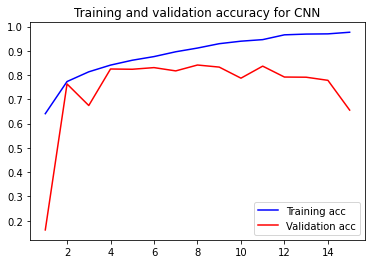

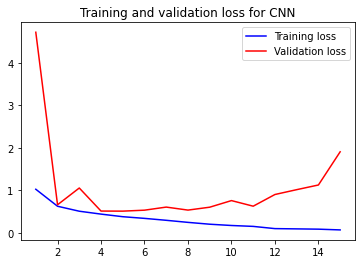

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

By using data augmentation on previous model it seems validation accuracy is not improved.

Applying transfer learning using Densenet121 model 

Feature extraction

In [ ]:
from tensorflow.keras.applications import DenseNet121
conv_base = DenseNet121(weights='imagenet',
include_top=False,
input_shape=(150, 150, 3))

#freeze the weight of the convolutional base
conv_base.trainable=False

# get the summary of the model to view its architecture
conv_base.summary()

Model: "densenet121"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 156, 156, 3)  0          ['input_3[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 75, 75, 64)   9408        ['zero_padding2d_2[0][0]']       
                                                                                        

In [ ]:
def build_pretrained(input_shape):

  #Configuring the model architecture

  #input layer for getting the input image
  input = keras.Input(shape=input_shape)

  #Add the data_augmentation layers here:
  x=data_augmentation(input)

  #rescaling layer for rescalign pixels to [0,1] range
  x = layers.experimental.preprocessing.Rescaling(1./255)(x)
  
  #Using the pre-trained conv_base
  x = conv_base(x)

  #Global Average pooling. This will get an input of shape (height, width, channels) the average of each feature map and returns a vector of size channels.
  x = layers.GlobalAveragePooling2D()(x)

  #x= layers.Dropout(0.3)(x)

  #The final output layer has 6 neurons with softmax activation to output the probability of the target class 
  output=layers.Dense(6, activation="softmax")(x)
  
  #create a model and set its input and output and return it
  model = keras.Model(inputs=input, outputs=output)
  return model

pretrained_model=build_pretrained(input_shape=(150,150,3))
print(pretrained_model.summary())

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 random_flip_1 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 random_rotation_1 (RandomRo  (None, 150, 150, 3)      0         
 tation)                                                         
                                                                 
 random_zoom_1 (RandomZoom)  (None, 150, 150, 3)       0         
                                                                 
 rescaling_1 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 densenet121 (Functional)    (None, 4, 4, 1024)        7037504   
                                                           

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3,
    decay_steps=1000,
    decay_rate=0.9)

#compiling the mode
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
pretrained_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=['accuracy'], optimizer=opt) 

#callback for early stopping. stop the training if the validation_loss does not improve after 10 epochs
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, min_delta=1e-4, restore_best_weights=True)

history = pretrained_model.fit(
            train_dataset,
            validation_data = validation_dataset,
            epochs = 50,
            verbose = 1,
            callbacks=[early_stopping])

Epoch 1/50
351/351 [==============================] - 41s 100ms/step - loss: 0.6102 - accuracy: 0.7742 - val_loss: 0.3623 - val_accuracy: 0.8695
Epoch 2/50
351/351 [==============================] - 33s 94ms/step - loss: 0.3881 - accuracy: 0.8549 - val_loss: 0.3212 - val_accuracy: 0.8887
Epoch 3/50
351/351 [==============================] - 34s 95ms/step - loss: 0.3548 - accuracy: 0.8689 - val_loss: 0.3079 - val_accuracy: 0.8962
Epoch 4/50
351/351 [==============================] - 34s 96ms/step - loss: 0.3420 - accuracy: 0.8735 - val_loss: 0.3143 - val_accuracy: 0.8919
Epoch 5/50
351/351 [==============================] - 33s 95ms/step - loss: 0.3288 - accuracy: 0.8786 - val_loss: 0.2992 - val_accuracy: 0.8976
Epoch 6/50
351/351 [==============================] - 33s 94ms/step - loss: 0.3239 - accuracy: 0.8809 - val_loss: 0.3025 - val_accuracy: 0.9030
Epoch 7/50
351/351 [==============================] - 33s 95ms/step - loss: 0.3124 - accuracy: 0.8843 - val_loss: 0.2790 - val_accuracy

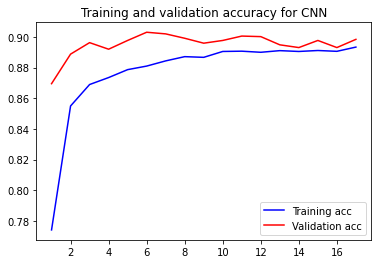

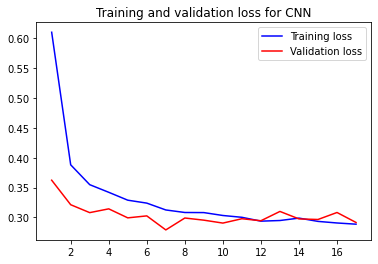

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

Fine tuning

In [ ]:
conv_base.trainable = True

#set trainable to False for all layers except the last 9 , that is freeze the weights for all layers except the last 9 layers
for layer in conv_base.layers[:-9]:
    layer.trainable=False

#set trainable to True for the convolutional layhers in the last 9 layers ( the last convolutional block in DENSENET121). 
for layer in conv_base.layers[-9:]:
    # we only want to unfreez the convolutional layers (batch normalizataion layers remain frozen)
    if layer.name.endswith("conv"):
      layer.trainable=True

print(pretrained_model.summary())

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 random_flip_1 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 random_rotation_1 (RandomRo  (None, 150, 150, 3)      0         
 tation)                                                         
                                                                 
 random_zoom_1 (RandomZoom)  (None, 150, 150, 3)       0         
                                                                 
 rescaling_1 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 densenet121 (Functional)    (None, 4, 4, 1024)        7037504   
                                                           

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-5,
    decay_steps=1000,
    decay_rate=0.9)

#compiling the model
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
pretrained_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), metrics=['accuracy'], optimizer=opt) 

history = pretrained_model.fit(
            train_dataset,
            validation_data = validation_dataset,
            epochs = 50,
            verbose = 1,
            callbacks=[early_stopping])

Epoch 1/50
351/351 [==============================] - 42s 102ms/step - loss: 0.3904 - accuracy: 0.8575 - val_loss: 0.3472 - val_accuracy: 0.8798
Epoch 2/50
351/351 [==============================] - 34s 97ms/step - loss: 0.3565 - accuracy: 0.8692 - val_loss: 0.3376 - val_accuracy: 0.8852
Epoch 3/50
351/351 [==============================] - 34s 98ms/step - loss: 0.3532 - accuracy: 0.8698 - val_loss: 0.3311 - val_accuracy: 0.8887
Epoch 4/50
351/351 [==============================] - 35s 101ms/step - loss: 0.3366 - accuracy: 0.8752 - val_loss: 0.3285 - val_accuracy: 0.8902
Epoch 5/50
351/351 [==============================] - 34s 96ms/step - loss: 0.3371 - accuracy: 0.8767 - val_loss: 0.3240 - val_accuracy: 0.8902
Epoch 6/50
351/351 [==============================] - 34s 96ms/step - loss: 0.3347 - accuracy: 0.8750 - val_loss: 0.3213 - val_accuracy: 0.8916
Epoch 7/50
351/351 [==============================] - 34s 98ms/step - loss: 0.3278 - accuracy: 0.8815 - val_loss: 0.3208 - val_accurac

By using transfer learning the validation accuracy is increased to 90% which is a quite a lot improvement from baseline model but fine tuning did not improve the accuracy further

Evaluating the performance of the model on test data

In [ ]:
test_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    shuffle=False,
    batch_size=32,
    image_size=(150, 150)
)

Found 3000 files belonging to 6 classes.


In [ ]:
test_loss, test_acc = pretrained_model.evaluate(test_dataset)
print('test acc:', test_acc)

94/94 [==============================] - 6s 67ms/step - loss: 0.3086 - accuracy: 0.8947
test acc: 0.8946666717529297


Accuracy of the model on test data is 89%

In [ ]:
predictions = pretrained_model.predict(test_dataset)
predictions = np.argmax(predictions, axis=1)

94/94 [==============================] - 6s 50ms/step


In [ ]:
true_class_indices = np.concatenate([y for x, y in test_dataset], axis=0)

Confusion matrix

In [ ]:
from sklearn.metrics import confusion_matrix
cf_matrix= confusion_matrix(true_class_indices, predictions)
print(cf_matrix)

[[393   1   2   2   4  35]
 [  0 469   1   2   0   2]
 [  0   3 463  60  26   1]
 [  3   3  75 424  19   1]
 [  4   2  10   4 486   4]
 [ 47   0   3   0   2 449]]


Model suffers most in predicting mountain as glacier and street as buildings and vice versa 

In [ ]:
errors = np.where(predictions != true_class_indices)[0]
print(errors)
print(true_class_indices)

[   5   17   31   34   51   64   74   76   86   88   90  106  119  125
  138  151  153  155  159  167  176  184  185  186  195  197  226  231
  252  254  256  270  274  306  338  341  342  353  361  375  376  384
  395  434  475  516  605  730  788  925  926  936  944  950  963  965
  979  998 1001 1002 1033 1039 1040 1046 1048 1054 1061 1071 1074 1076
 1077 1079 1081 1086 1089 1092 1103 1106 1108 1113 1117 1122 1123 1136
 1156 1159 1166 1219 1230 1233 1237 1239 1240 1243 1258 1266 1271 1281
 1282 1293 1294 1296 1298 1305 1308 1317 1318 1319 1320 1329 1338 1342
 1346 1349 1351 1354 1356 1359 1364 1377 1381 1382 1385 1386 1389 1391
 1392 1404 1412 1418 1432 1433 1441 1443 1444 1448 1451 1458 1462 1466
 1467 1470 1476 1478 1479 1488 1491 1495 1498 1505 1515 1523 1525 1532
 1535 1541 1543 1549 1552 1555 1564 1569 1570 1571 1575 1584 1586 1597
 1600 1605 1608 1612 1617 1619 1632 1634 1645 1654 1656 1657 1665 1667
 1673 1679 1681 1690 1691 1692 1696 1700 1701 1709 1715 1717 1724 1726
 1734 

1/1 [==============================] - 0s 35ms/step
True label is: 0, CNN predicted 3


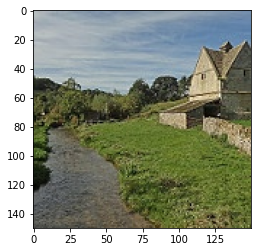

True label is: 0, CNN predicted 4


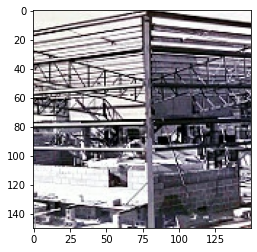

True label is: 0, CNN predicted 5


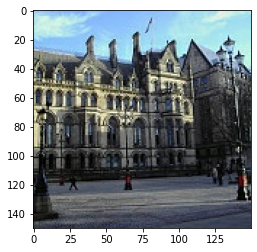

1/1 [==============================] - 0s 32ms/step
True label is: 0, CNN predicted 5


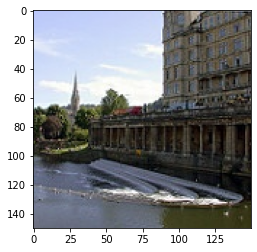

True label is: 0, CNN predicted 5


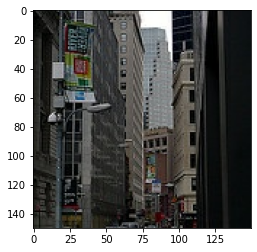

1/1 [==============================] - 0s 32ms/step
True label is: 0, CNN predicted 5


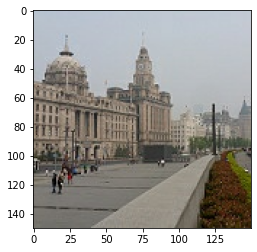

True label is: 0, CNN predicted 2


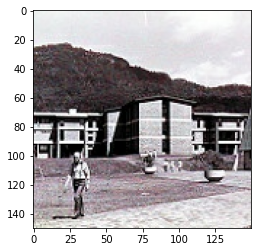

True label is: 0, CNN predicted 5


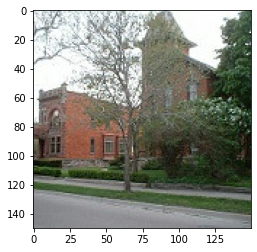

True label is: 0, CNN predicted 5


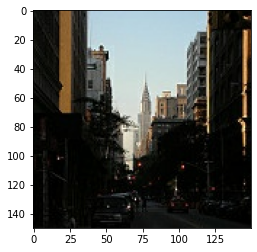

True label is: 0, CNN predicted 5


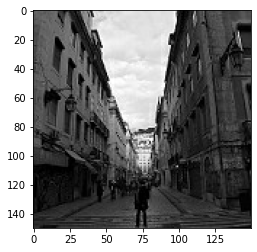

True label is: 0, CNN predicted 5


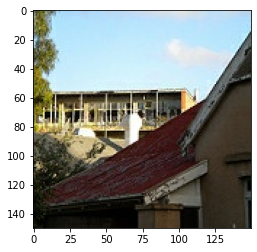

1/1 [==============================] - 0s 32ms/step
True label is: 0, CNN predicted 5


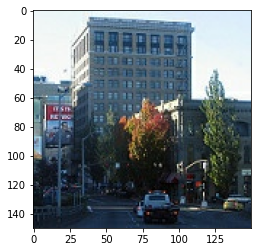

True label is: 0, CNN predicted 5


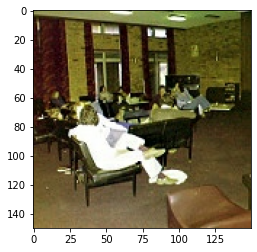

True label is: 0, CNN predicted 5


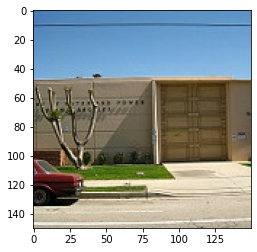

1/1 [==============================] - 0s 32ms/step
True label is: 0, CNN predicted 5


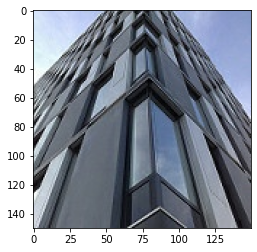

True label is: 0, CNN predicted 5


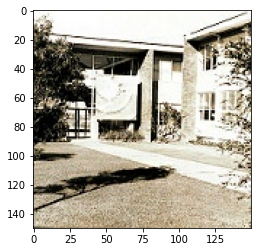

True label is: 0, CNN predicted 5


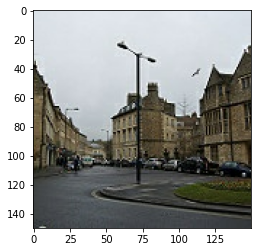

True label is: 0, CNN predicted 5


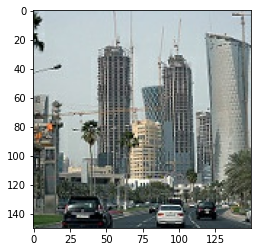

True label is: 0, CNN predicted 2


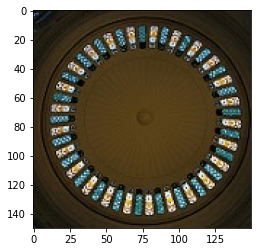

1/1 [==============================] - 0s 40ms/step
True label is: 0, CNN predicted 4


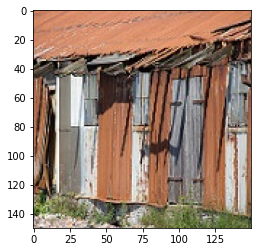

True label is: 0, CNN predicted 5


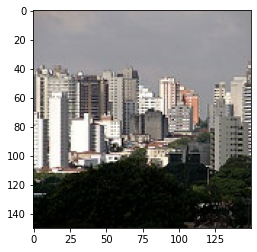

True label is: 0, CNN predicted 5


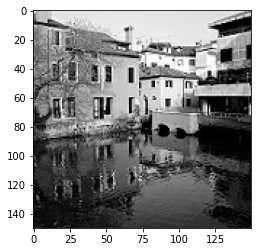

True label is: 0, CNN predicted 5


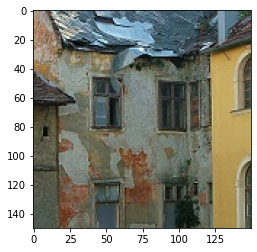

True label is: 0, CNN predicted 4


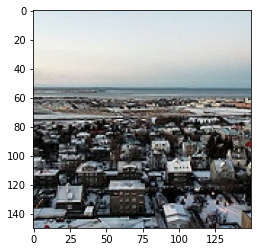

1/1 [==============================] - 0s 34ms/step
True label is: 0, CNN predicted 5


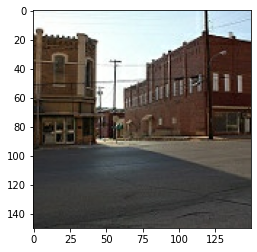

True label is: 0, CNN predicted 5


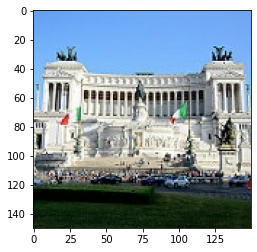

1/1 [==============================] - 0s 45ms/step
True label is: 0, CNN predicted 5


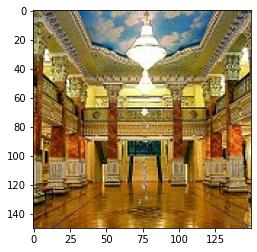

True label is: 0, CNN predicted 5


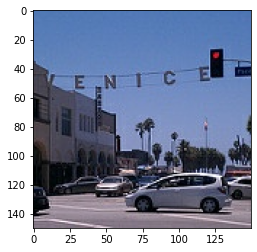

True label is: 0, CNN predicted 5


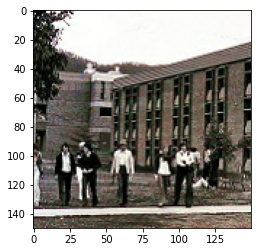

True label is: 0, CNN predicted 5


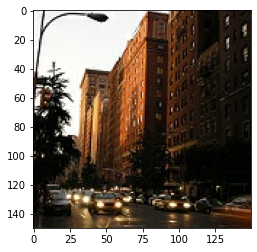

1/1 [==============================] - 0s 62ms/step
True label is: 0, CNN predicted 5


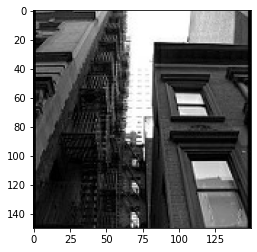

True label is: 0, CNN predicted 5


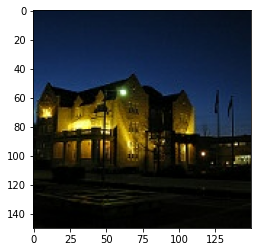

True label is: 0, CNN predicted 4


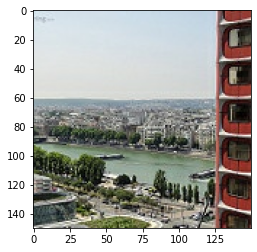

1/1 [==============================] - 0s 49ms/step
True label is: 0, CNN predicted 5


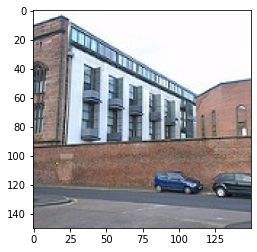

1/1 [==============================] - 0s 52ms/step
True label is: 0, CNN predicted 5


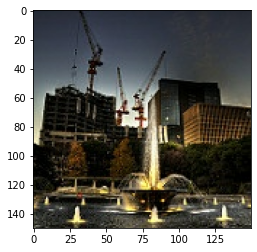

True label is: 0, CNN predicted 5


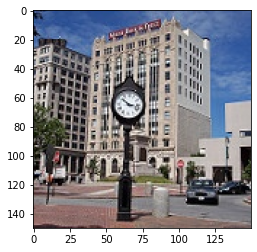

True label is: 0, CNN predicted 5


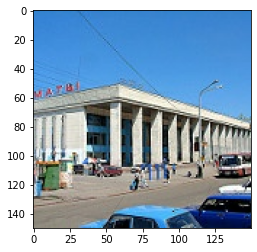

1/1 [==============================] - 0s 45ms/step
True label is: 0, CNN predicted 5


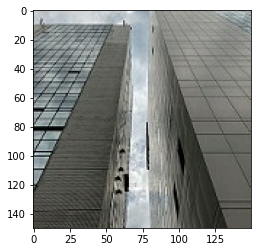

True label is: 0, CNN predicted 5


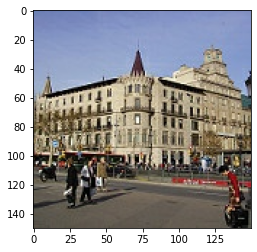

True label is: 0, CNN predicted 5


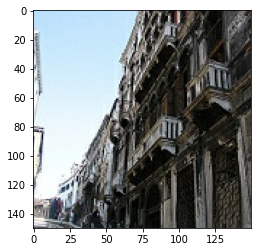

True label is: 0, CNN predicted 3


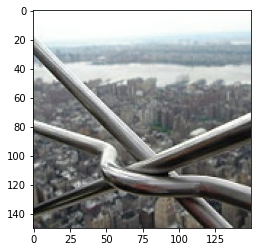

1/1 [==============================] - 0s 49ms/step
True label is: 0, CNN predicted 5


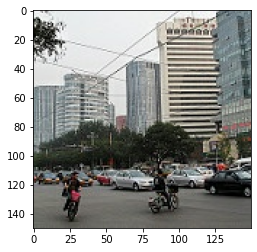

True label is: 0, CNN predicted 1


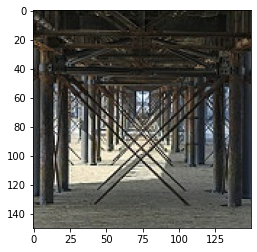

1/1 [==============================] - 0s 42ms/step
True label is: 0, CNN predicted 5


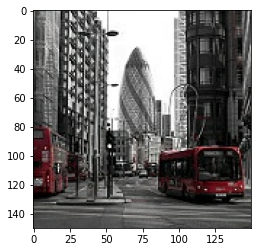

1/1 [==============================] - 0s 44ms/step
True label is: 1, CNN predicted 3


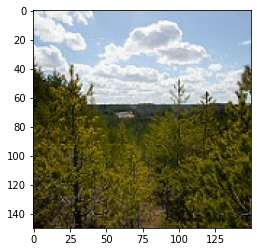

1/1 [==============================] - 0s 37ms/step
True label is: 1, CNN predicted 5


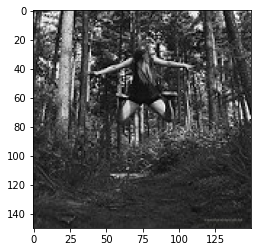

1/1 [==============================] - 0s 49ms/step
True label is: 1, CNN predicted 5


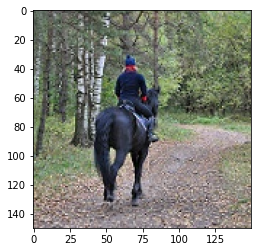

1/1 [==============================] - 0s 33ms/step
True label is: 1, CNN predicted 2


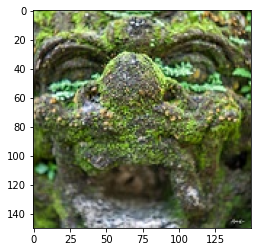

1/1 [==============================] - 0s 33ms/step
True label is: 1, CNN predicted 3


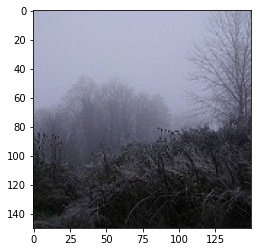

1/1 [==============================] - 0s 35ms/step
True label is: 2, CNN predicted 3


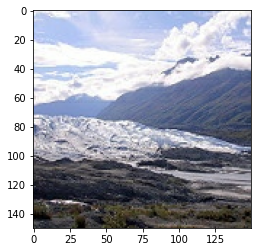

True label is: 2, CNN predicted 3


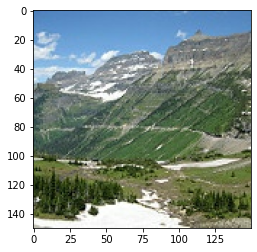

1/1 [==============================] - 0s 48ms/step
True label is: 2, CNN predicted 4


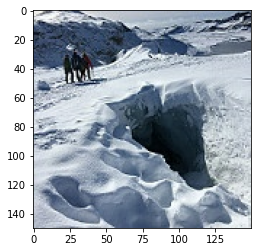

True label is: 2, CNN predicted 3


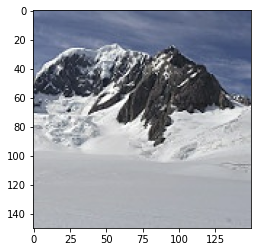

True label is: 2, CNN predicted 1


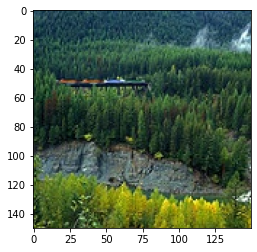

1/1 [==============================] - 0s 47ms/step
True label is: 2, CNN predicted 3


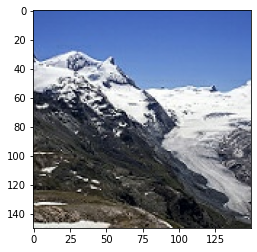

True label is: 2, CNN predicted 5


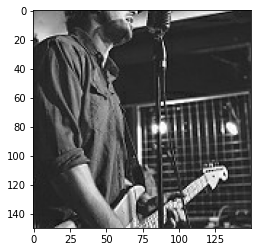

True label is: 2, CNN predicted 4


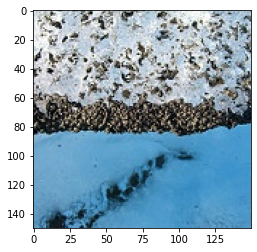

1/1 [==============================] - 0s 44ms/step
True label is: 2, CNN predicted 3


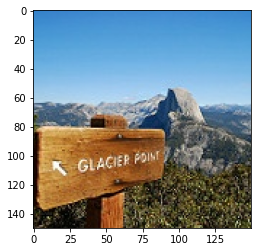

True label is: 2, CNN predicted 3


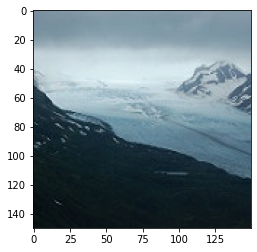

True label is: 2, CNN predicted 3


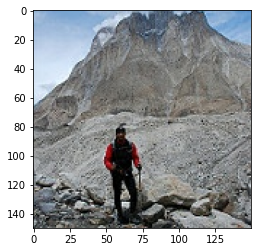

1/1 [==============================] - 0s 46ms/step
True label is: 2, CNN predicted 3


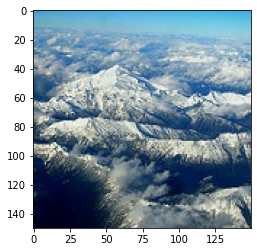

True label is: 2, CNN predicted 4


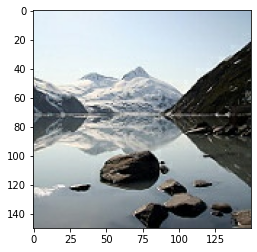

True label is: 2, CNN predicted 3


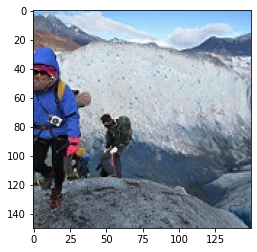

True label is: 2, CNN predicted 4


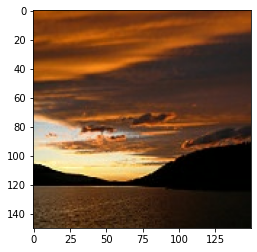

True label is: 2, CNN predicted 4


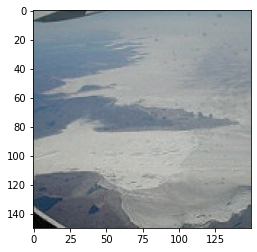

True label is: 2, CNN predicted 3


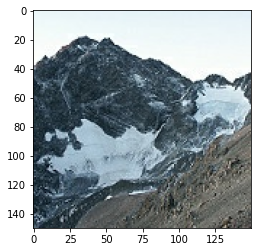

1/1 [==============================] - 0s 51ms/step
True label is: 2, CNN predicted 3


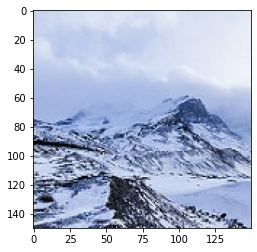

True label is: 2, CNN predicted 3


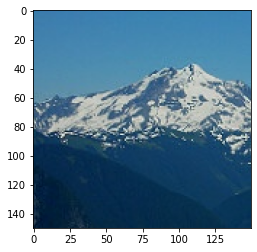

True label is: 2, CNN predicted 4


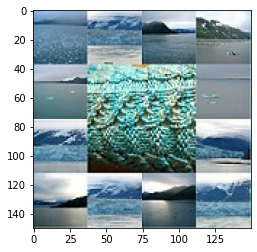

True label is: 2, CNN predicted 3


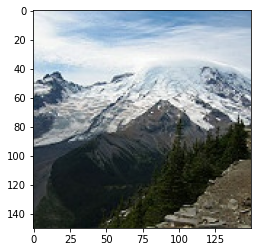

True label is: 2, CNN predicted 3


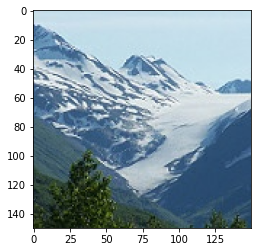

True label is: 2, CNN predicted 3


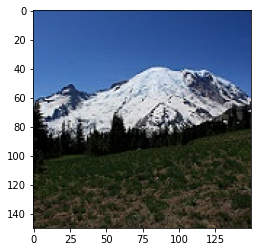

True label is: 2, CNN predicted 4


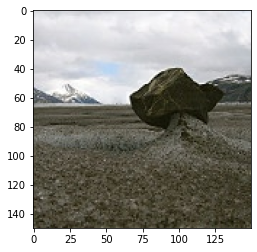

True label is: 2, CNN predicted 4


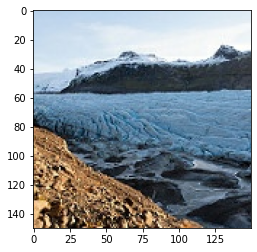

1/1 [==============================] - 0s 54ms/step
True label is: 2, CNN predicted 3


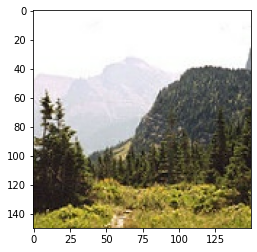

True label is: 2, CNN predicted 3


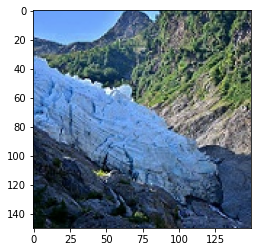

True label is: 2, CNN predicted 3


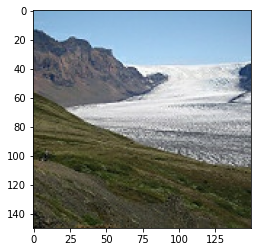

True label is: 2, CNN predicted 4


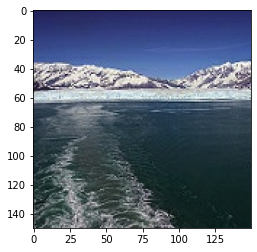

True label is: 2, CNN predicted 1


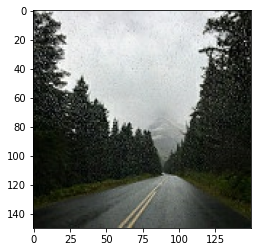

True label is: 2, CNN predicted 4


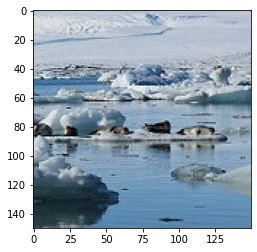

True label is: 2, CNN predicted 3


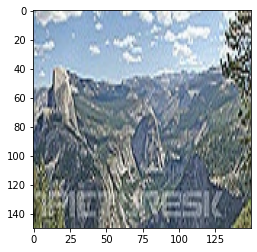

1/1 [==============================] - 0s 44ms/step
True label is: 2, CNN predicted 3


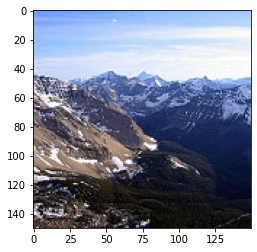

True label is: 2, CNN predicted 3


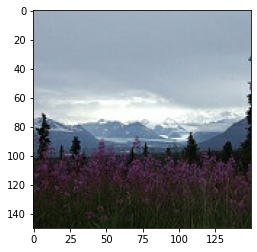

True label is: 2, CNN predicted 4


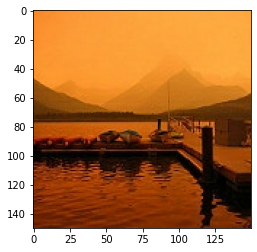

1/1 [==============================] - 0s 51ms/step
True label is: 2, CNN predicted 4


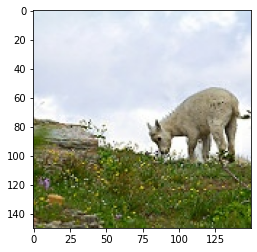

True label is: 2, CNN predicted 3


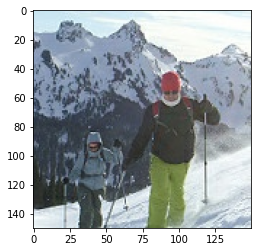

True label is: 2, CNN predicted 4


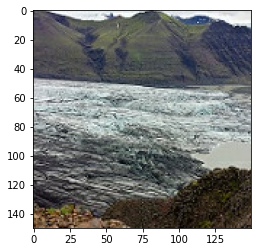

1/1 [==============================] - 0s 31ms/step
True label is: 2, CNN predicted 3


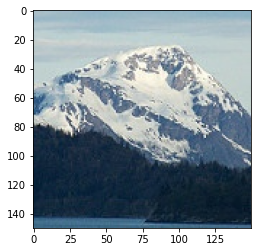

True label is: 2, CNN predicted 4


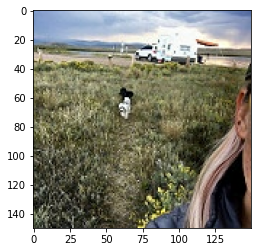

True label is: 2, CNN predicted 3


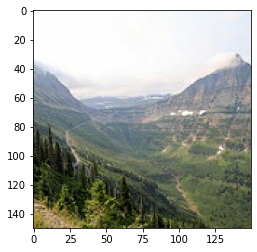

True label is: 2, CNN predicted 3


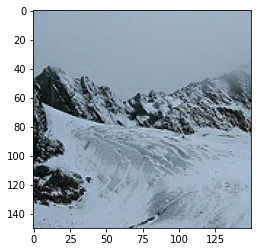

True label is: 2, CNN predicted 4


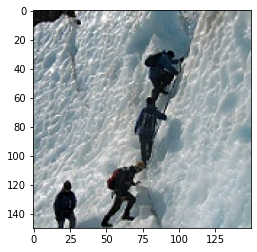

True label is: 2, CNN predicted 4


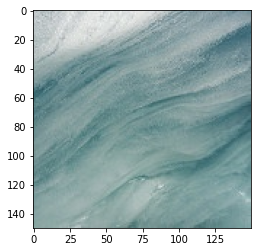

True label is: 2, CNN predicted 3


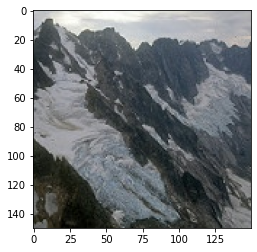

1/1 [==============================] - 0s 48ms/step
True label is: 2, CNN predicted 3


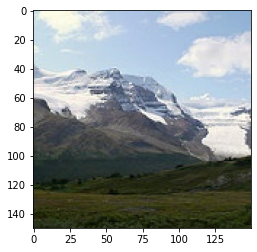

True label is: 2, CNN predicted 3


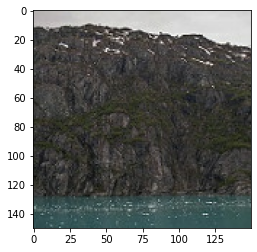

True label is: 2, CNN predicted 3


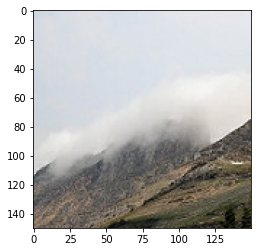

1/1 [==============================] - 0s 48ms/step
True label is: 2, CNN predicted 3


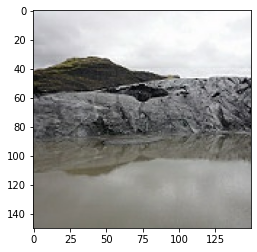

True label is: 2, CNN predicted 4


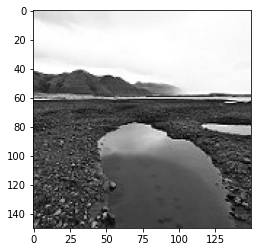

True label is: 2, CNN predicted 3


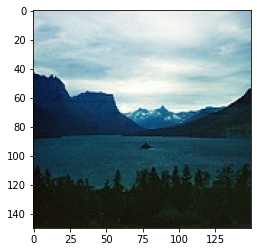

True label is: 2, CNN predicted 4


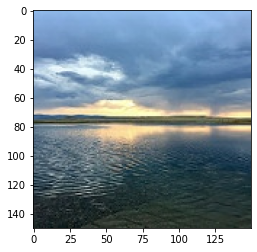

True label is: 2, CNN predicted 3


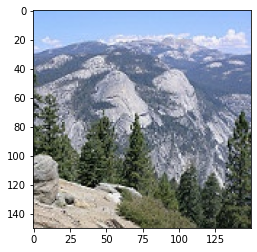

True label is: 2, CNN predicted 3


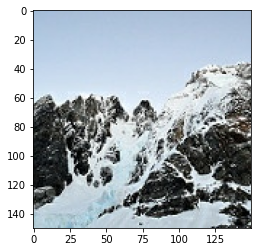

True label is: 2, CNN predicted 3


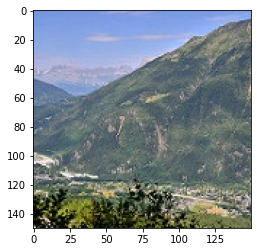

True label is: 2, CNN predicted 3


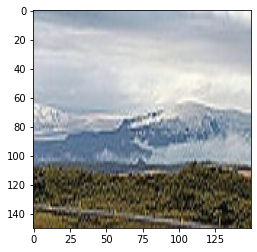

1/1 [==============================] - 0s 52ms/step
True label is: 2, CNN predicted 4


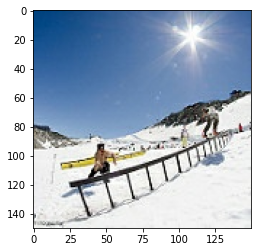

True label is: 2, CNN predicted 3


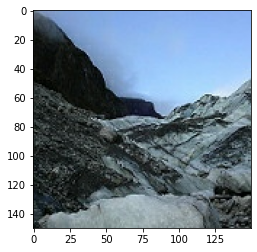

True label is: 2, CNN predicted 4


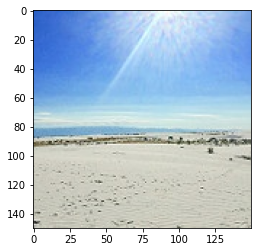

True label is: 2, CNN predicted 3


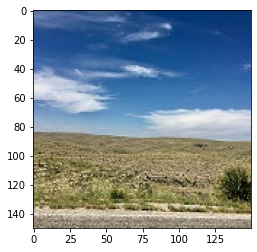

True label is: 2, CNN predicted 3


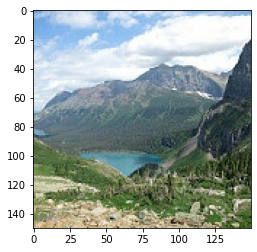

True label is: 2, CNN predicted 4


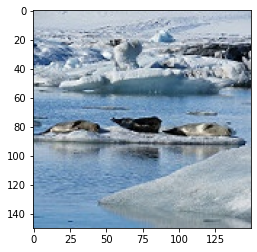

True label is: 2, CNN predicted 4


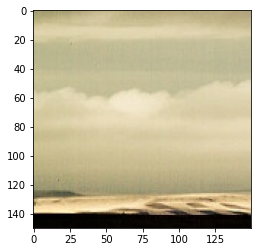

1/1 [==============================] - 0s 46ms/step
True label is: 2, CNN predicted 3


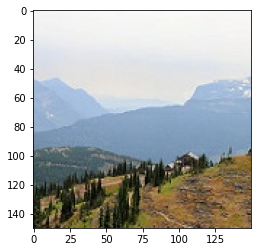

True label is: 2, CNN predicted 3


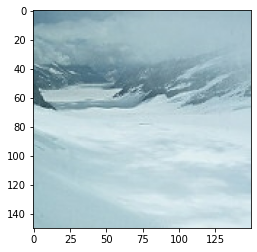

True label is: 2, CNN predicted 3


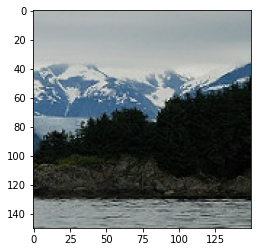

True label is: 2, CNN predicted 3


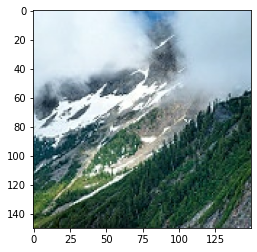

True label is: 2, CNN predicted 3


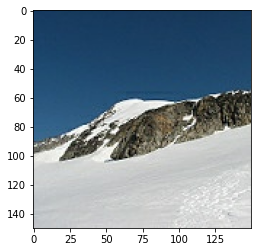

True label is: 2, CNN predicted 3


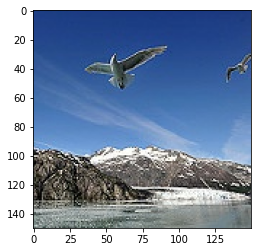

True label is: 2, CNN predicted 4


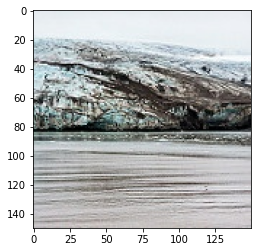

1/1 [==============================] - 0s 47ms/step
True label is: 2, CNN predicted 3


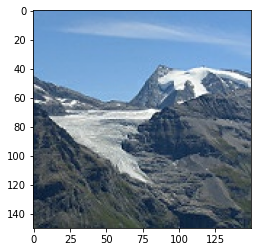

True label is: 2, CNN predicted 3


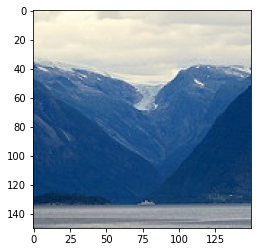

True label is: 2, CNN predicted 3


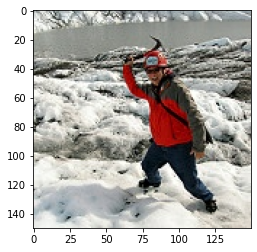

True label is: 2, CNN predicted 3


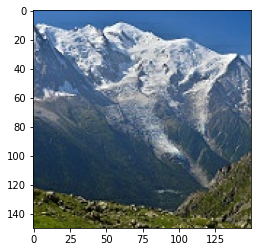

True label is: 2, CNN predicted 3


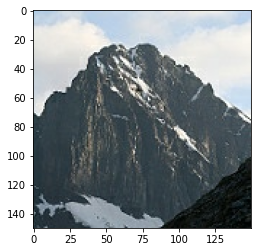

True label is: 2, CNN predicted 4


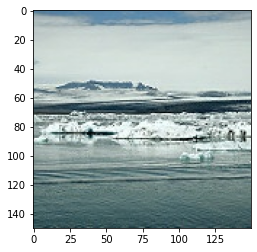

True label is: 2, CNN predicted 3


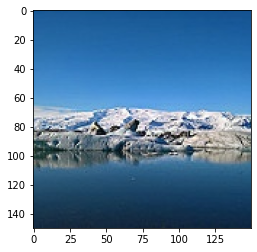

True label is: 2, CNN predicted 1


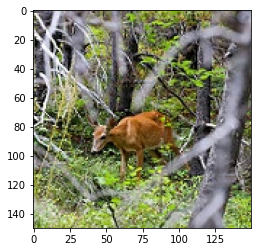

True label is: 2, CNN predicted 3


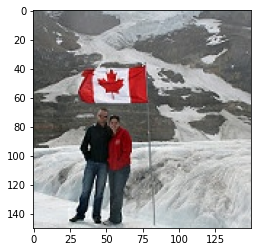

1/1 [==============================] - 0s 48ms/step
True label is: 2, CNN predicted 4


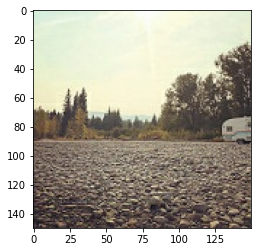

True label is: 2, CNN predicted 3


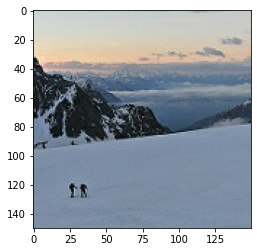

True label is: 2, CNN predicted 3


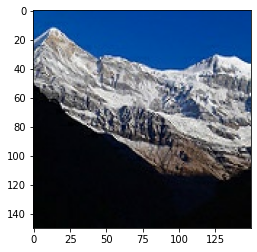

True label is: 2, CNN predicted 4


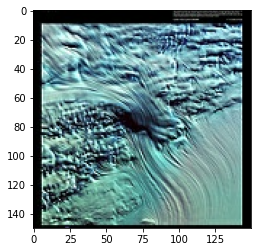

1/1 [==============================] - 0s 51ms/step
True label is: 2, CNN predicted 3


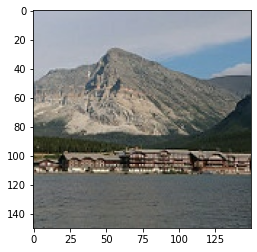

True label is: 2, CNN predicted 3


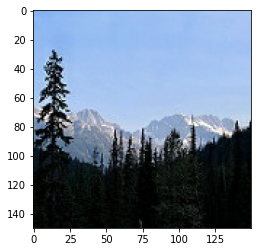

True label is: 2, CNN predicted 3


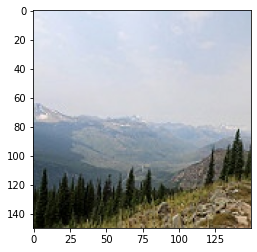

True label is: 2, CNN predicted 3


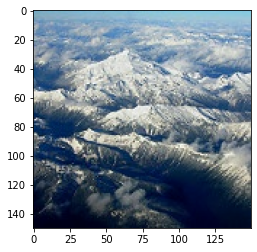

True label is: 2, CNN predicted 3


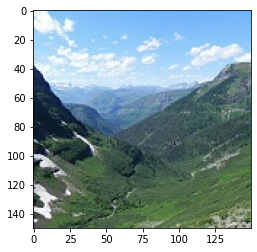

True label is: 2, CNN predicted 3


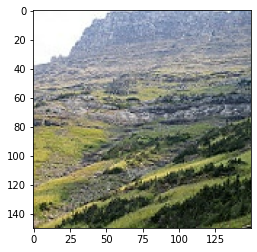

True label is: 2, CNN predicted 3


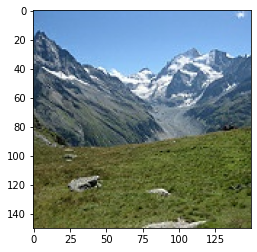

True label is: 3, CNN predicted 2


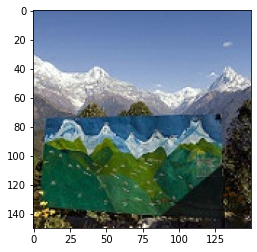

True label is: 3, CNN predicted 4


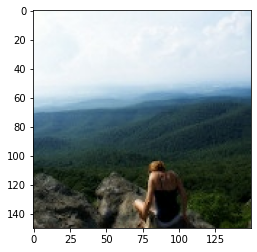

True label is: 3, CNN predicted 2


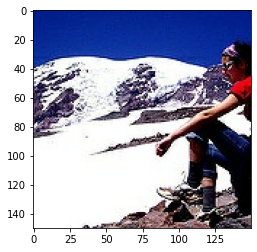

1/1 [==============================] - 0s 48ms/step
True label is: 3, CNN predicted 2


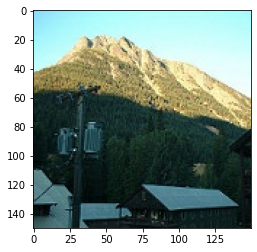

True label is: 3, CNN predicted 5


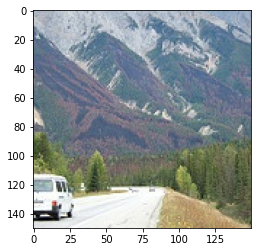

True label is: 3, CNN predicted 2


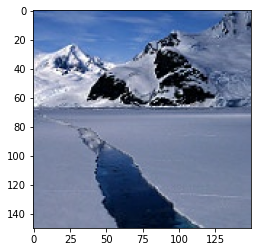

True label is: 3, CNN predicted 4


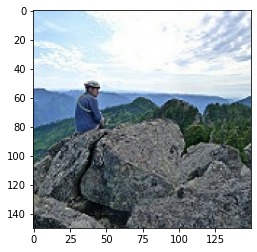

True label is: 3, CNN predicted 2


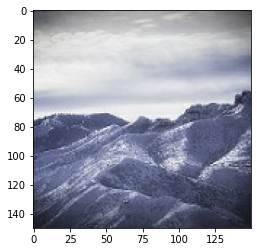

True label is: 3, CNN predicted 2


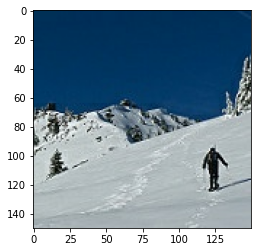

True label is: 3, CNN predicted 0


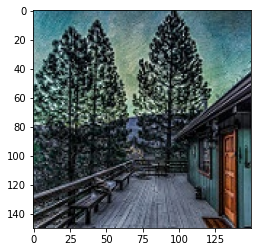

1/1 [==============================] - 0s 45ms/step
True label is: 3, CNN predicted 2


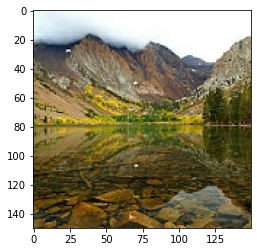

True label is: 3, CNN predicted 2


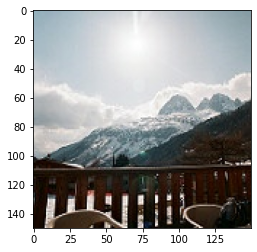

True label is: 3, CNN predicted 2


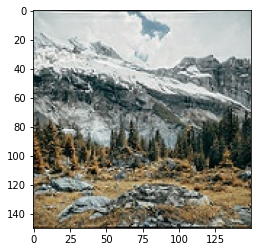

True label is: 3, CNN predicted 4


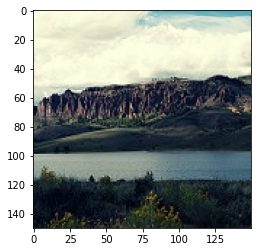

True label is: 3, CNN predicted 2


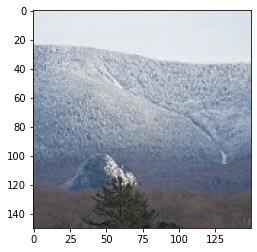

True label is: 3, CNN predicted 2


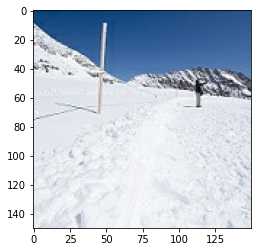

1/1 [==============================] - 0s 50ms/step
True label is: 3, CNN predicted 2


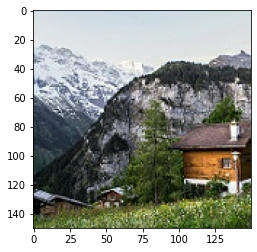

True label is: 3, CNN predicted 2


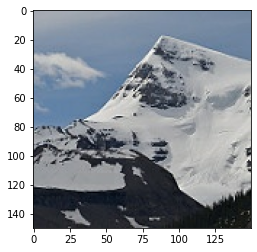

True label is: 3, CNN predicted 2


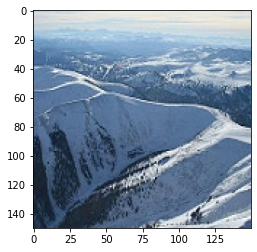

True label is: 3, CNN predicted 2


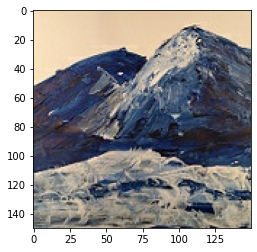

True label is: 3, CNN predicted 2


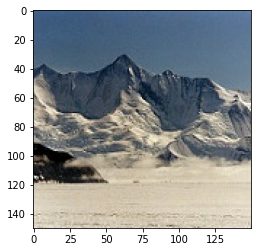

True label is: 3, CNN predicted 2


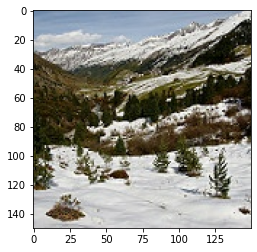

1/1 [==============================] - 0s 46ms/step
True label is: 3, CNN predicted 2


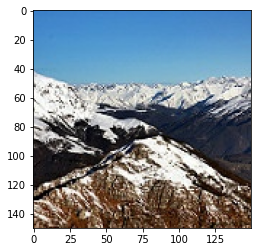

True label is: 3, CNN predicted 2


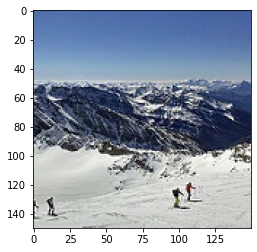

True label is: 3, CNN predicted 2


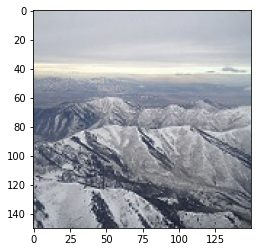

True label is: 3, CNN predicted 2


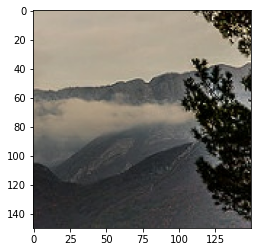

True label is: 3, CNN predicted 2


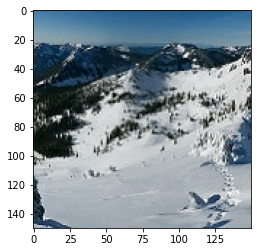

True label is: 3, CNN predicted 2


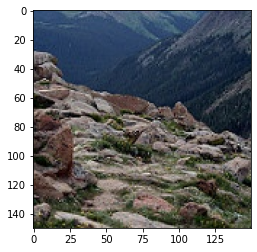

True label is: 3, CNN predicted 4


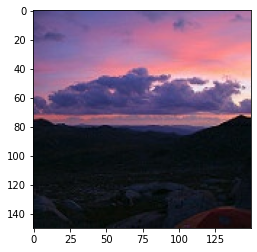

1/1 [==============================] - 0s 43ms/step
True label is: 3, CNN predicted 2


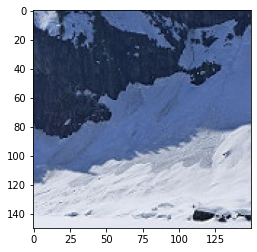

True label is: 3, CNN predicted 2


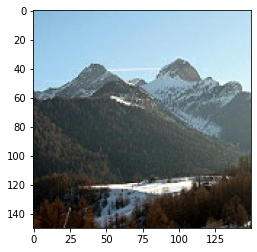

True label is: 3, CNN predicted 4


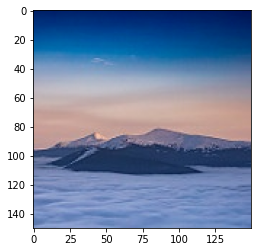

True label is: 3, CNN predicted 2


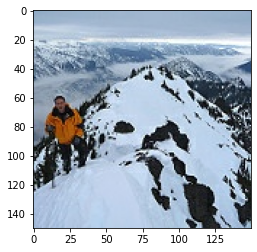

True label is: 3, CNN predicted 2


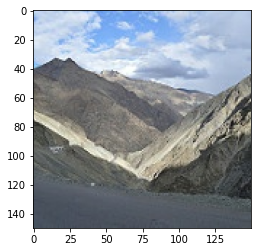

True label is: 3, CNN predicted 2


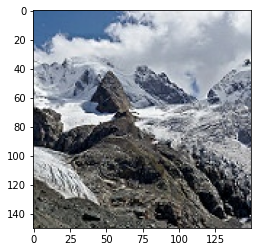

1/1 [==============================] - 0s 46ms/step
True label is: 3, CNN predicted 0


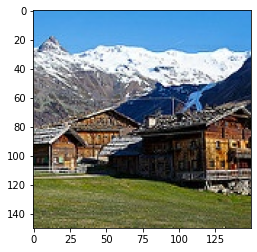

True label is: 3, CNN predicted 2


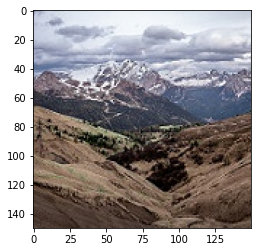

True label is: 3, CNN predicted 2


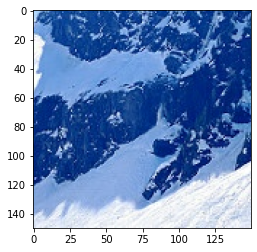

True label is: 3, CNN predicted 2


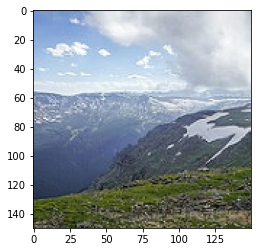

True label is: 3, CNN predicted 2


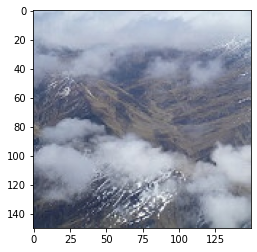

True label is: 3, CNN predicted 4


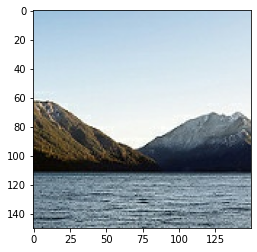

1/1 [==============================] - 0s 49ms/step
True label is: 3, CNN predicted 2


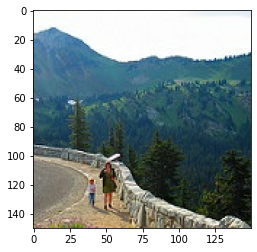

True label is: 3, CNN predicted 4


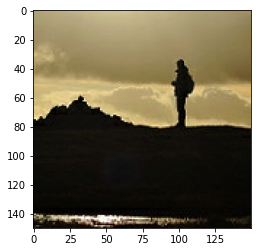

True label is: 3, CNN predicted 2


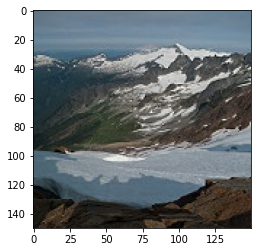

True label is: 3, CNN predicted 4


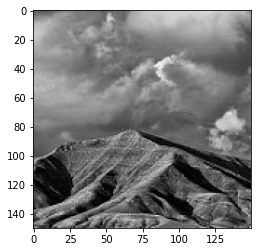

True label is: 3, CNN predicted 4


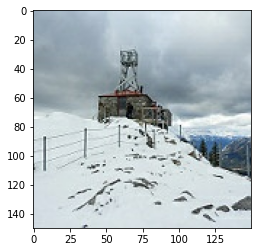

True label is: 3, CNN predicted 4


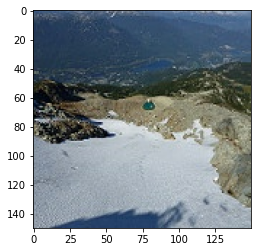

True label is: 3, CNN predicted 2


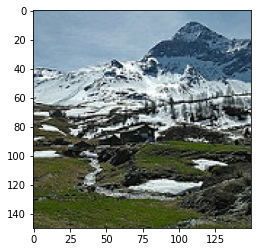

True label is: 3, CNN predicted 2


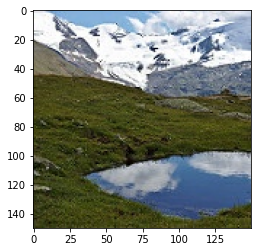

1/1 [==============================] - 0s 50ms/step
True label is: 3, CNN predicted 2


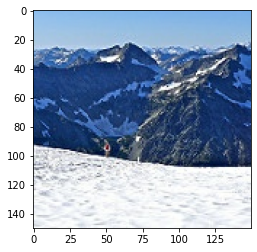

True label is: 3, CNN predicted 2


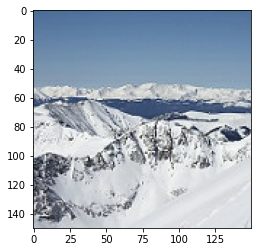

True label is: 3, CNN predicted 2


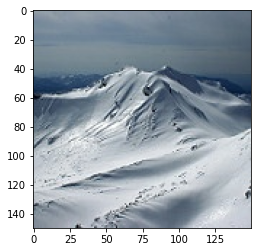

True label is: 3, CNN predicted 2


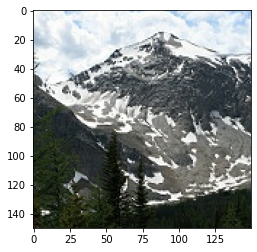

True label is: 3, CNN predicted 2


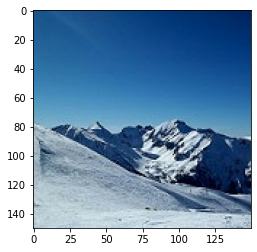

True label is: 3, CNN predicted 2


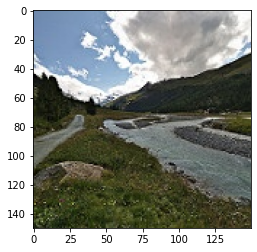

True label is: 3, CNN predicted 2


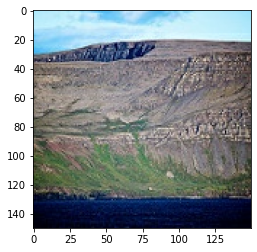

True label is: 3, CNN predicted 4


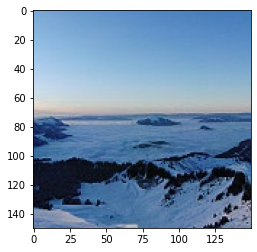

1/1 [==============================] - 0s 44ms/step
True label is: 3, CNN predicted 2


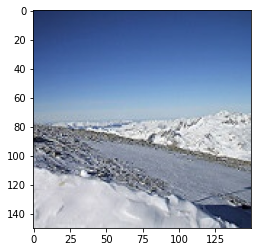

True label is: 3, CNN predicted 4


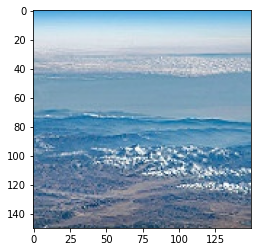

True label is: 3, CNN predicted 2


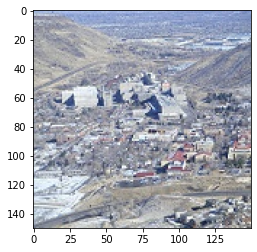

True label is: 3, CNN predicted 4


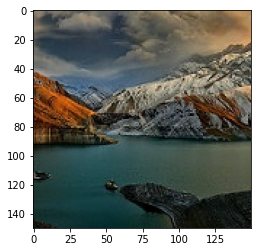

True label is: 3, CNN predicted 4


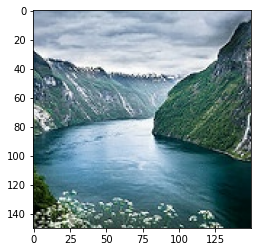

True label is: 3, CNN predicted 2


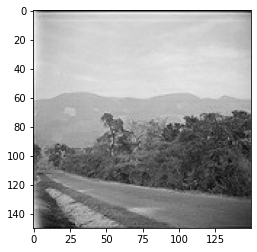

True label is: 3, CNN predicted 2


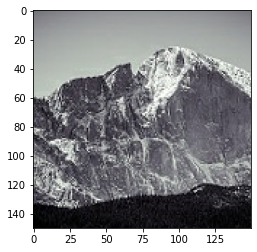

True label is: 3, CNN predicted 0


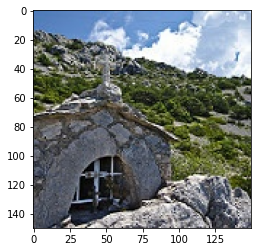

1/1 [==============================] - 0s 47ms/step
True label is: 3, CNN predicted 4


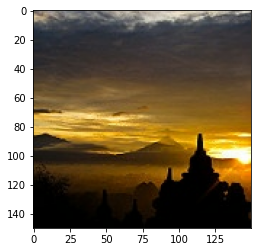

True label is: 3, CNN predicted 2


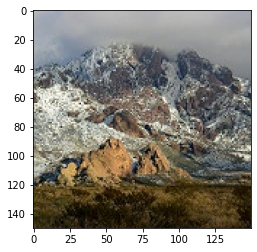

True label is: 3, CNN predicted 1


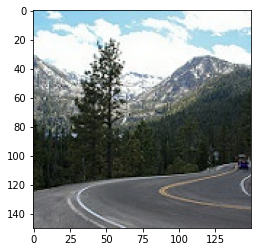

1/1 [==============================] - 0s 45ms/step
True label is: 3, CNN predicted 2


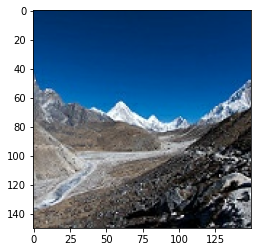

True label is: 3, CNN predicted 4


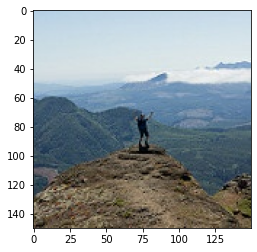

True label is: 3, CNN predicted 2


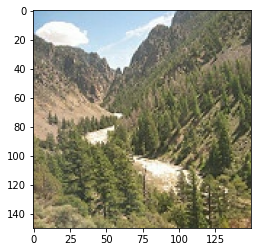

True label is: 3, CNN predicted 2


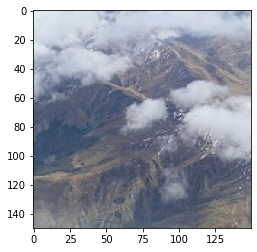

True label is: 3, CNN predicted 2


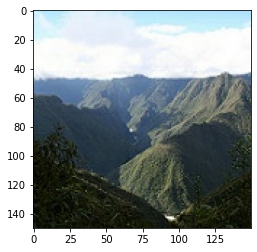

1/1 [==============================] - 0s 47ms/step
True label is: 3, CNN predicted 2


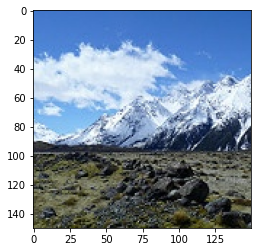

True label is: 3, CNN predicted 2


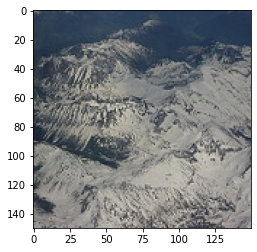

True label is: 3, CNN predicted 2


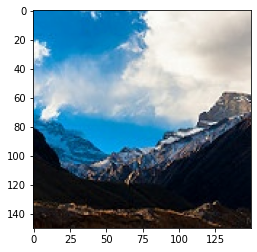

True label is: 3, CNN predicted 2


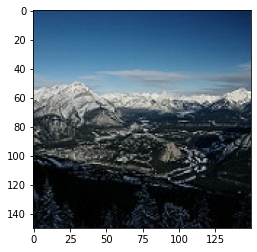

True label is: 3, CNN predicted 2


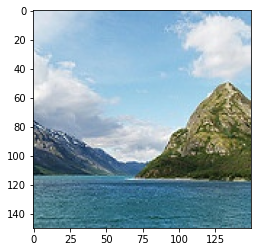

True label is: 3, CNN predicted 2


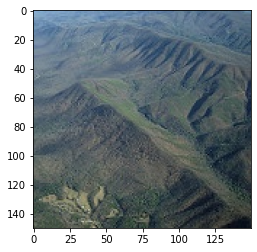

1/1 [==============================] - 0s 59ms/step
True label is: 3, CNN predicted 2


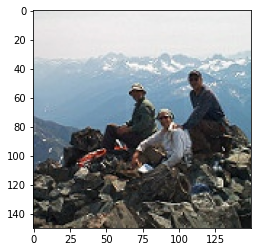

True label is: 3, CNN predicted 4


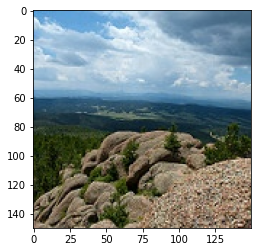

True label is: 3, CNN predicted 2


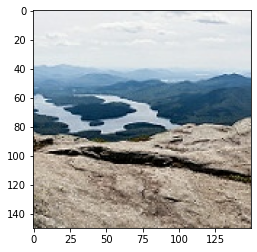

1/1 [==============================] - 0s 44ms/step
True label is: 3, CNN predicted 2


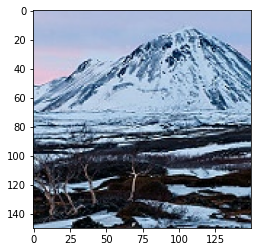

True label is: 3, CNN predicted 4


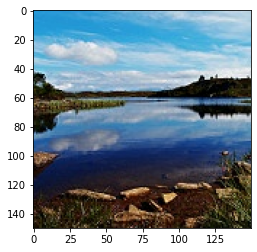

True label is: 3, CNN predicted 2


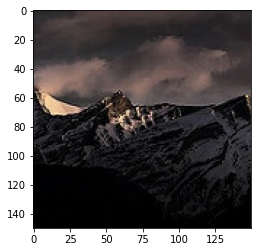

True label is: 3, CNN predicted 2


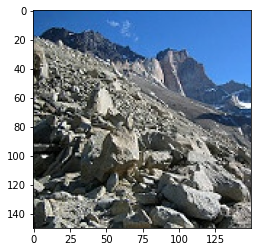

True label is: 3, CNN predicted 2


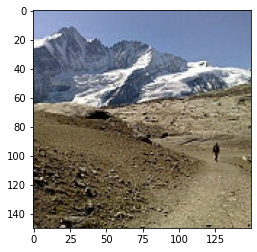

True label is: 3, CNN predicted 1


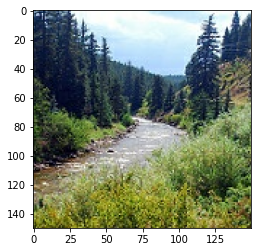

True label is: 3, CNN predicted 2


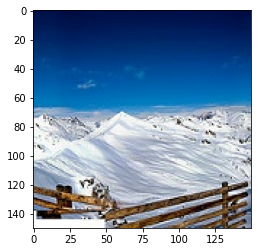

1/1 [==============================] - 0s 49ms/step
True label is: 3, CNN predicted 2


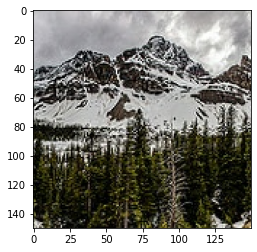

True label is: 3, CNN predicted 2


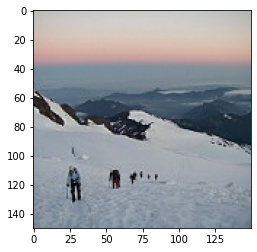

True label is: 3, CNN predicted 2


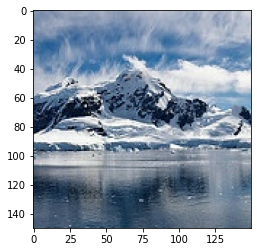

True label is: 3, CNN predicted 1


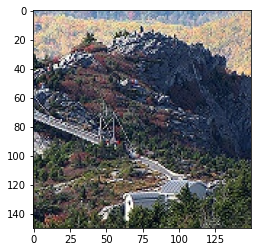

True label is: 3, CNN predicted 2


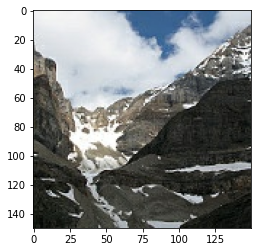

1/1 [==============================] - 0s 48ms/step
True label is: 3, CNN predicted 2


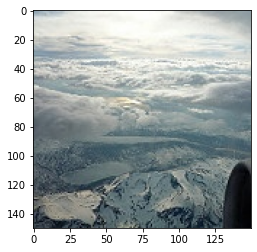

True label is: 3, CNN predicted 2


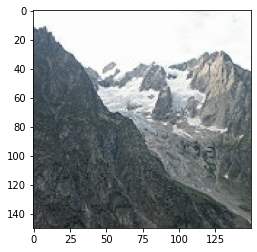

True label is: 3, CNN predicted 2


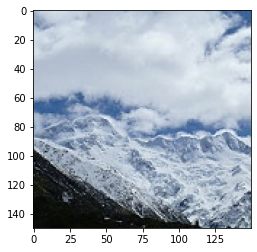

True label is: 3, CNN predicted 2


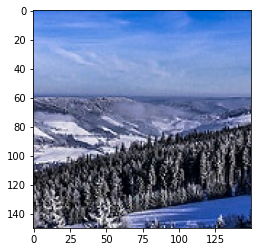

True label is: 3, CNN predicted 4


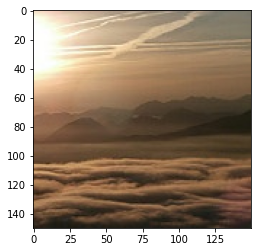

True label is: 3, CNN predicted 2


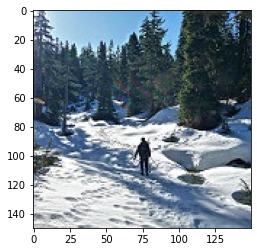

1/1 [==============================] - 0s 58ms/step
True label is: 3, CNN predicted 2


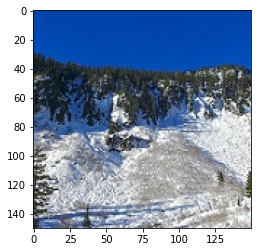

True label is: 4, CNN predicted 3


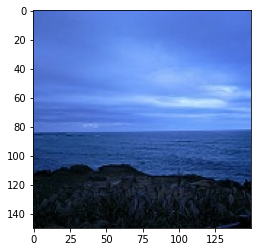

True label is: 4, CNN predicted 0


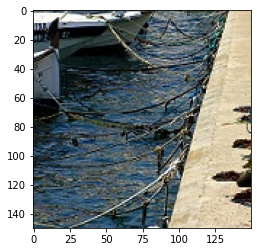

True label is: 4, CNN predicted 2


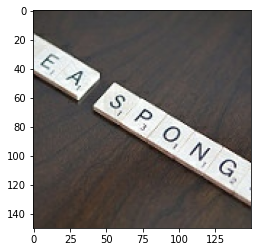

1/1 [==============================] - 0s 45ms/step
True label is: 4, CNN predicted 2


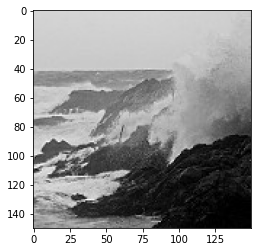

True label is: 4, CNN predicted 1


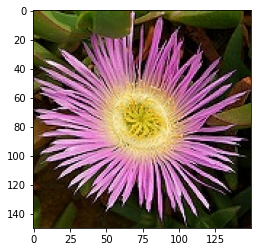

1/1 [==============================] - 0s 49ms/step
True label is: 4, CNN predicted 2


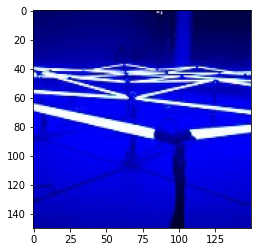

True label is: 4, CNN predicted 2


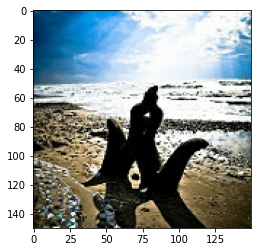

1/1 [==============================] - 0s 46ms/step
True label is: 4, CNN predicted 5


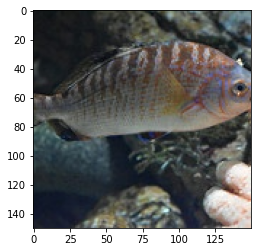

True label is: 4, CNN predicted 3


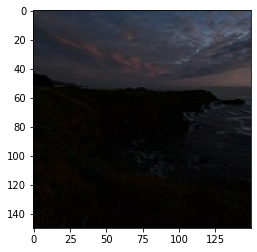

1/1 [==============================] - 0s 45ms/step
True label is: 4, CNN predicted 2


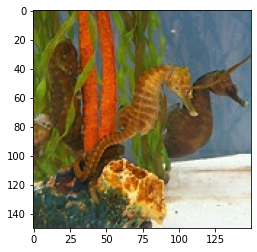

1/1 [==============================] - 0s 44ms/step
True label is: 4, CNN predicted 0


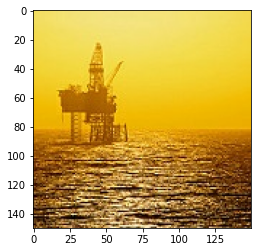

True label is: 4, CNN predicted 1


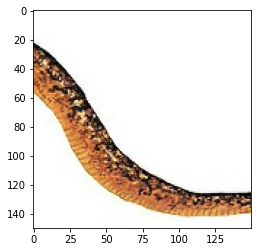

1/1 [==============================] - 0s 43ms/step
True label is: 4, CNN predicted 3


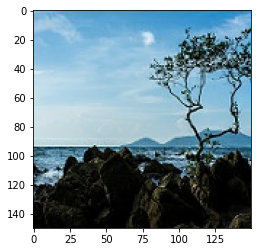

True label is: 4, CNN predicted 2


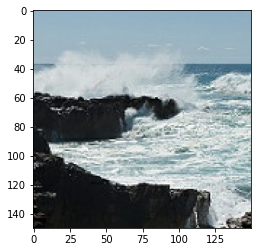

1/1 [==============================] - 0s 44ms/step
True label is: 4, CNN predicted 5


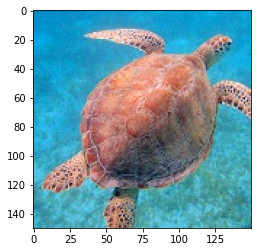

True label is: 4, CNN predicted 5


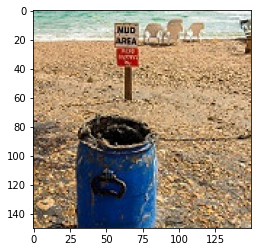

1/1 [==============================] - 0s 49ms/step
True label is: 4, CNN predicted 3


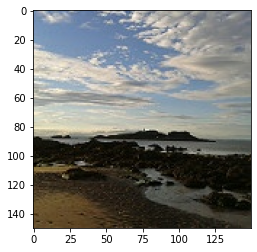

1/1 [==============================] - 0s 45ms/step
True label is: 4, CNN predicted 5


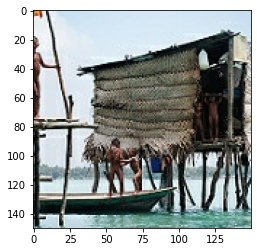

True label is: 4, CNN predicted 2


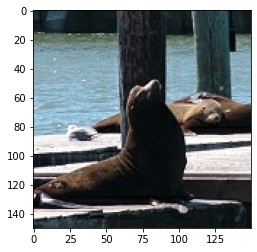

True label is: 4, CNN predicted 2


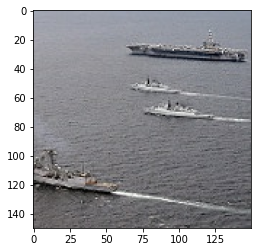

1/1 [==============================] - 0s 47ms/step
True label is: 4, CNN predicted 2


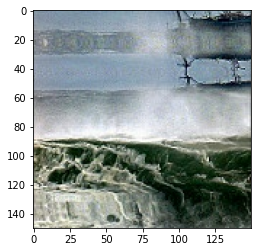

1/1 [==============================] - 0s 32ms/step
True label is: 4, CNN predicted 2


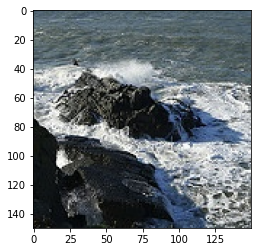

1/1 [==============================] - 0s 46ms/step
True label is: 4, CNN predicted 0


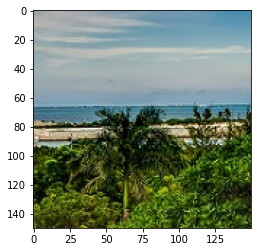

1/1 [==============================] - 0s 46ms/step
True label is: 4, CNN predicted 0


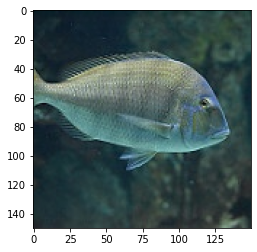

1/1 [==============================] - 0s 44ms/step
True label is: 5, CNN predicted 0


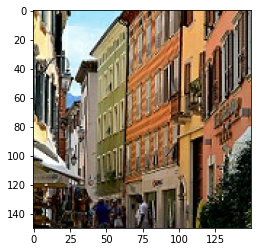

True label is: 5, CNN predicted 0


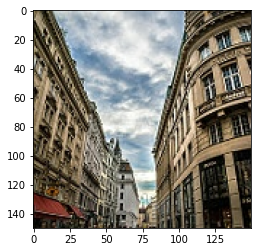

True label is: 5, CNN predicted 0


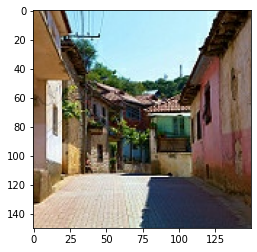

1/1 [==============================] - 0s 50ms/step
True label is: 5, CNN predicted 0


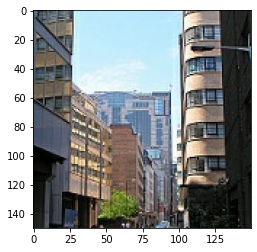

True label is: 5, CNN predicted 0


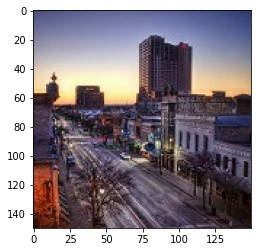

1/1 [==============================] - 0s 47ms/step
True label is: 5, CNN predicted 0


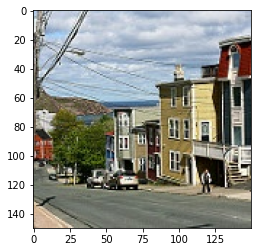

True label is: 5, CNN predicted 0


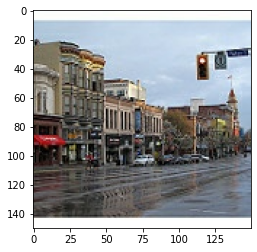

True label is: 5, CNN predicted 0


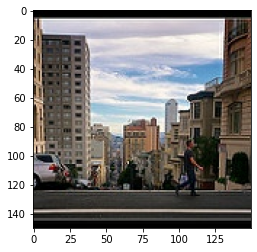

True label is: 5, CNN predicted 0


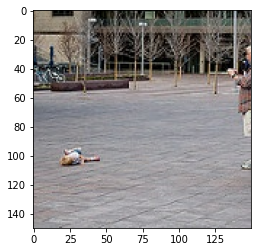

1/1 [==============================] - 0s 46ms/step
True label is: 5, CNN predicted 2


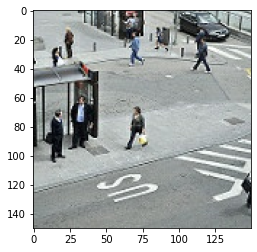

True label is: 5, CNN predicted 0


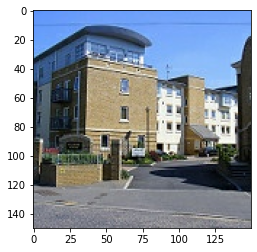

1/1 [==============================] - 0s 62ms/step
True label is: 5, CNN predicted 0


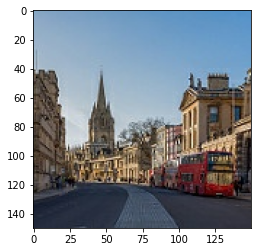

True label is: 5, CNN predicted 0


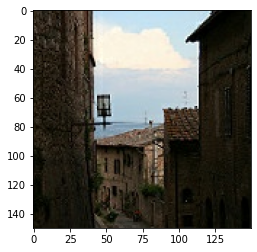

True label is: 5, CNN predicted 0


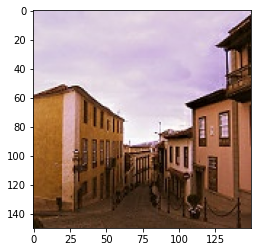

1/1 [==============================] - 0s 43ms/step
True label is: 5, CNN predicted 0


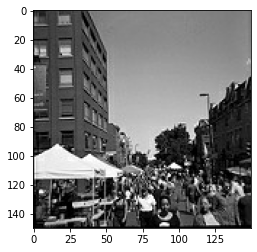

True label is: 5, CNN predicted 0


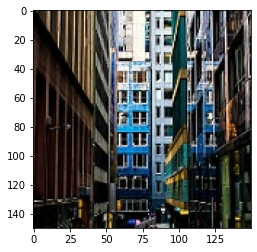

True label is: 5, CNN predicted 0


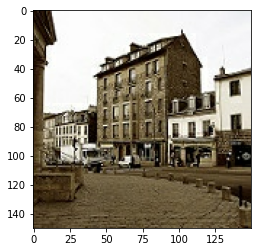

True label is: 5, CNN predicted 0


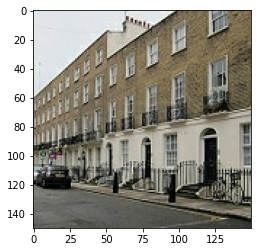

1/1 [==============================] - 0s 47ms/step
True label is: 5, CNN predicted 0


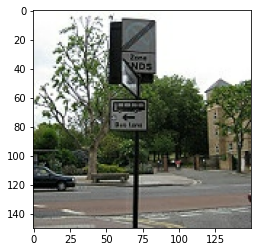

True label is: 5, CNN predicted 0


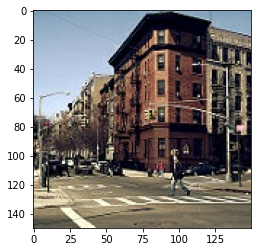

True label is: 5, CNN predicted 0


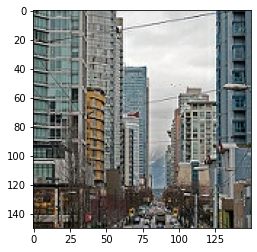

True label is: 5, CNN predicted 0


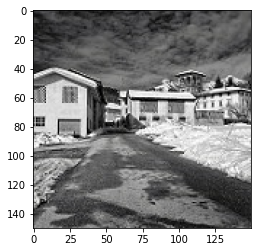

True label is: 5, CNN predicted 0


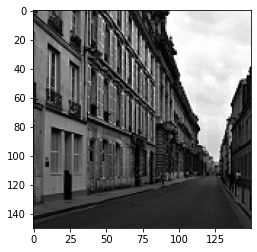

1/1 [==============================] - 0s 50ms/step
True label is: 5, CNN predicted 0


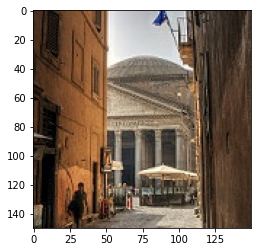

1/1 [==============================] - 0s 45ms/step
True label is: 5, CNN predicted 0


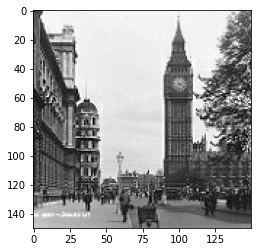

True label is: 5, CNN predicted 0


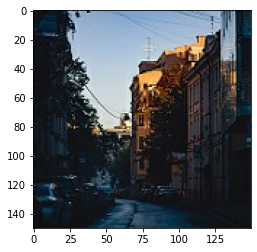

True label is: 5, CNN predicted 0


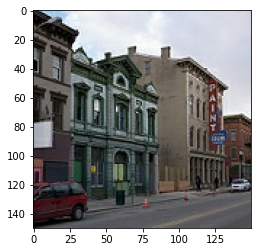

True label is: 5, CNN predicted 0


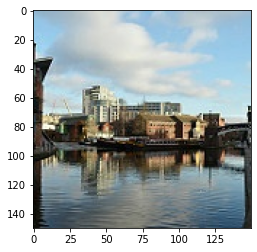

True label is: 5, CNN predicted 0


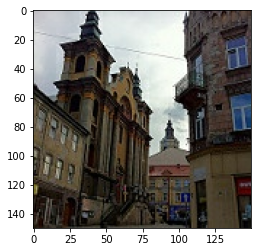

True label is: 5, CNN predicted 0


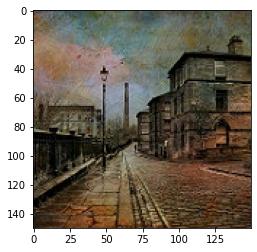

True label is: 5, CNN predicted 4


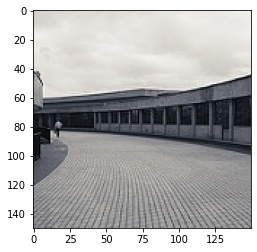

1/1 [==============================] - 0s 45ms/step
True label is: 5, CNN predicted 0


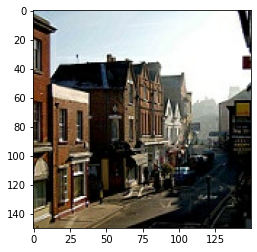

True label is: 5, CNN predicted 0


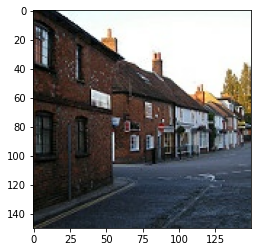

True label is: 5, CNN predicted 0


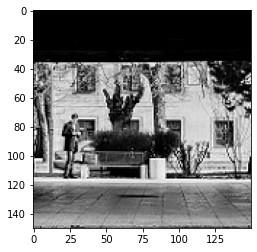

1/1 [==============================] - 0s 43ms/step
True label is: 5, CNN predicted 0


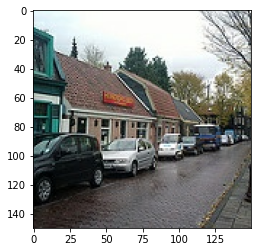

True label is: 5, CNN predicted 0


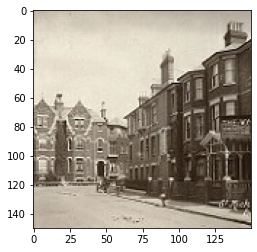

True label is: 5, CNN predicted 0


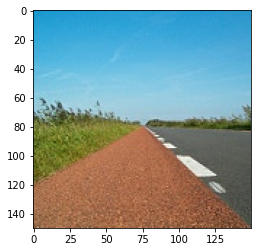

True label is: 5, CNN predicted 0


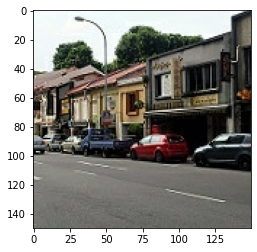

1/1 [==============================] - 0s 55ms/step
True label is: 5, CNN predicted 2


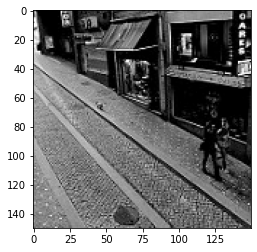

True label is: 5, CNN predicted 0


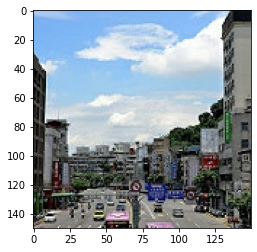

True label is: 5, CNN predicted 0


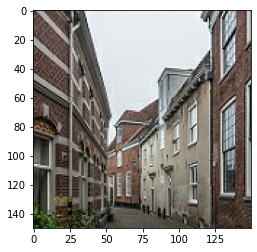

1/1 [==============================] - 0s 47ms/step
True label is: 5, CNN predicted 0


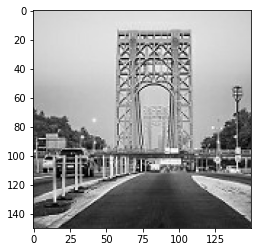

True label is: 5, CNN predicted 0


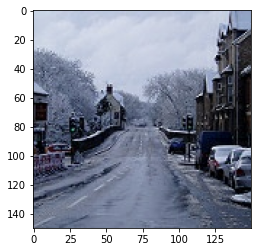

True label is: 5, CNN predicted 0


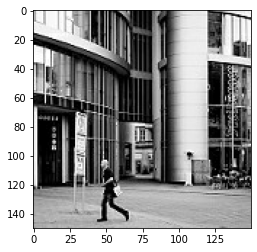

1/1 [==============================] - 0s 47ms/step
True label is: 5, CNN predicted 0


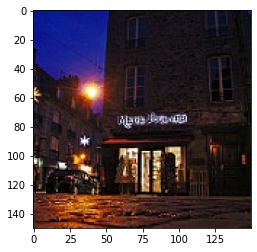

True label is: 5, CNN predicted 2


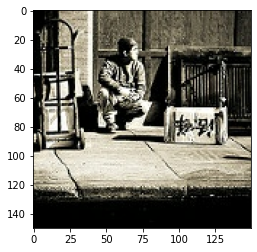

True label is: 5, CNN predicted 0


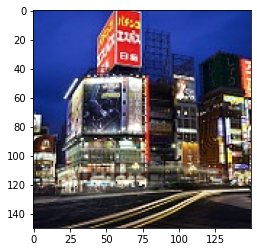

True label is: 5, CNN predicted 0


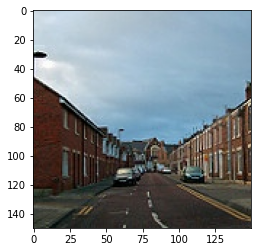

1/1 [==============================] - 2s 2s/step
True label is: 5, CNN predicted 0


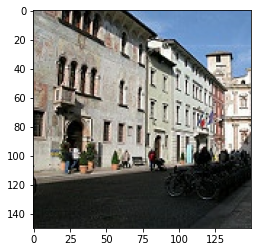

True label is: 5, CNN predicted 0


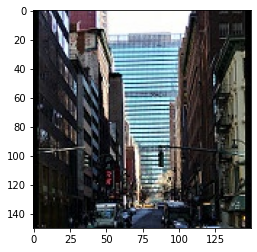

True label is: 5, CNN predicted 0


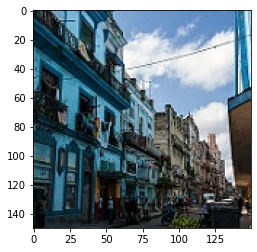

True label is: 5, CNN predicted 4


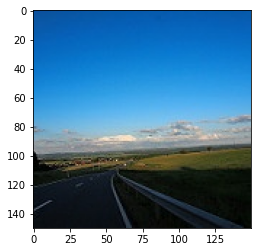

In [ ]:
batch_size=32
test_size=3000
batch_index=0

#Get each batch of images and labels in validation dataset
for image_batch,label_batch in test_dataset:
    if batch_index>math.ceil(test_size/batch_size):
        break;
    y_pred = pretrained_model.predict(image_batch)
    y_pred = np.argmax(y_pred, axis=1)

    y_pred_label= np.concatenate([y for x, y in test_dataset], axis=0)

    errors = np.where(y_pred != label_batch)[0]
    
    #display the missclassified images together with their predicted probabilities
    for i in errors:
        print(f"True label is: {label_batch[i]}, CNN predicted {y_pred[i]}") 
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        plt.show()
        
    #get the next batch
    batch_index=batch_index+1

In the model sited in the link https://www.kaggle.com/code/zain053/vgg16-intel-image-classification-ipynb VGG16 architecture is used for transfer learning and the loss function used is Categorical cross entropy and gives a test accuracy of 81%
Whereas our model uses Densenet121 for transfer learning and loss function used is sparse categorical cross entropy and gives a test accuracy of 89%